##### Model Building To Predict the churn customers based on the usage 

##### High Level Steps in Model Building
- Step 1:Data Understanding
- Step 2:Data preparation and data cleaning 
- Step 3:Filter High Value Customers
- Step 4:Identify Churned Customers and remove attributes of churn phase
- Step 5:Feature Engineering
- Step 6: EDA - Univariate And Bivariate Analysis
- Step 7: Handling class imbalance
- Step 8:Build models to predict churn
    - Step 8.1:Logistic Regression with RFE
    - Step 8.2:Decision Tree
          - Step 8.2.1:With default parameters exept Depth
          - Step 8.2.2:Without setting any Hyperparameter Tuning
          - Step 8.2.3:Controlling the depth of the tree
    - Step 8.3:Random Forest
          - Step 8.3.1:Using random parameters
          - Step 8.3.2:Hyper parameter tuning
- Step 9:Summary And Conclusion
    - Step 9.1:Model comparison
    - Step 9.2:Identify important predictors
    - Step 9.3:Recommend strategies to manage customer churn
  

### Step 1:Data Understanding

In [1]:
# Import the different libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [2]:
data = pd.read_csv('telecom_churn_data.csv')

In [3]:
#Inspect a first few rows
data.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,...,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.385,...,0,1.0,1.0,1.0,NaN,968,30.4,0.0,101.20,3.58
1,7001865778,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,34.047,...,0,NaN,1.0,1.0,NaN,1006,0.0,0.0,0.00,0.00
2,7001625959,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,167.690,...,0,NaN,NaN,NaN,1.0,1103,0.0,0.0,4.17,0.00
3,7001204172,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,221.338,...,0,NaN,NaN,NaN,NaN,2491,0.0,0.0,0.00,0.00
4,7000142493,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,261.636,...,0,0.0,NaN,NaN,NaN,1526,0.0,0.0,0.00,0.00


In [4]:
data.shape

(99999, 226)

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Columns: 226 entries, mobile_number to sep_vbc_3g
dtypes: float64(179), int64(35), object(12)
memory usage: 172.4+ MB


##### As can be seen from the above 3 commands the dataset consists of 99999 rows with 226 coumns
The datatypes are float , int and object type

In [6]:
# Now let us understand which all columns have null values
round(100*(data.isnull().sum().sort_values(ascending=False)/len(data)),2)

arpu_3g_6            74.85
night_pck_user_6     74.85
total_rech_data_6    74.85
arpu_2g_6            74.85
max_rech_data_6      74.85
                     ...  
max_rech_amt_7        0.00
max_rech_amt_6        0.00
total_rech_amt_9      0.00
total_rech_amt_8      0.00
sep_vbc_3g            0.00
Length: 226, dtype: float64

##### As seen above there are columns with NULL values.
We will inpute the null values in the next step

### Step 2:Data preparation and data cleaning

In [7]:
# Now let us identify redundant columns if any
# If we go through the data dictionary the columns mobile_number and circle_id will not contribute to model predition hence let us drop these columns
redundant_cols = ['mobile_number','circle_id']
data = data.drop(redundant_cols,axis=1)

#### Missing value imputation
Let us drop the columns which is having NULL value % greater than 70% since those will not help in the predictions.
Let us create a list of such columns so that they can dropped in a single transaction

In [8]:
null70_col_list = []
for i in data.columns:
    count = 100* (data[i].isnull().sum()/data.shape[0])
    if count > 70:
        null70_col_list.append(i)

In [9]:
null70_col_list

['date_of_last_rech_data_6',
 'date_of_last_rech_data_7',
 'date_of_last_rech_data_8',
 'date_of_last_rech_data_9',
 'total_rech_data_6',
 'total_rech_data_7',
 'total_rech_data_8',
 'total_rech_data_9',
 'max_rech_data_6',
 'max_rech_data_7',
 'max_rech_data_8',
 'max_rech_data_9',
 'count_rech_2g_6',
 'count_rech_2g_7',
 'count_rech_2g_8',
 'count_rech_2g_9',
 'count_rech_3g_6',
 'count_rech_3g_7',
 'count_rech_3g_8',
 'count_rech_3g_9',
 'av_rech_amt_data_6',
 'av_rech_amt_data_7',
 'av_rech_amt_data_8',
 'av_rech_amt_data_9',
 'arpu_3g_6',
 'arpu_3g_7',
 'arpu_3g_8',
 'arpu_3g_9',
 'arpu_2g_6',
 'arpu_2g_7',
 'arpu_2g_8',
 'arpu_2g_9',
 'night_pck_user_6',
 'night_pck_user_7',
 'night_pck_user_8',
 'night_pck_user_9',
 'fb_user_6',
 'fb_user_7',
 'fb_user_8',
 'fb_user_9']

In [10]:
len(null70_col_list)

40

In [11]:
data=data.drop(null70_col_list,axis=1)

In [12]:
data.shape

(99999, 184)

In [13]:
# Now let us relook at the % of Null values in the remaining coumns
round(100*(data.isnull().sum().sort_values(ascending=False)/len(data)),2)

roam_ic_mou_9           7.75
loc_og_t2f_mou_9        7.75
loc_og_t2t_mou_9        7.75
std_ic_t2t_mou_9        7.75
std_ic_t2f_mou_9        7.75
                        ... 
arpu_6                  0.00
last_date_of_month_6    0.00
last_day_rch_amt_6      0.00
last_day_rch_amt_7      0.00
sep_vbc_3g              0.00
Length: 184, dtype: float64

##### The highest % of Null values is 7.75% which is acceptable. Hence as a next step we will try to impute the missing values

In [14]:
#Let us separate out the Int,Float,object type columns to impute the missing values
num_cols = data.select_dtypes(include='int64').columns
int_null_cols = []
for i in num_cols:
    count = data[i].isnull().sum()
    if count > 0:
        int_null_cols.append(i)
int_null_cols

[]

##### As seen above there are no Null values in Int type columns

In [15]:
##### Let us find float type columns having Null values
float_cols = data.select_dtypes(include='float64').columns
float_null_cols = []
for i in float_cols:
    count = data[i].isnull().sum()
    if count > 0:
        float_null_cols.append(i)
float_null_cols

['loc_og_t2o_mou',
 'std_og_t2o_mou',
 'loc_ic_t2o_mou',
 'onnet_mou_6',
 'onnet_mou_7',
 'onnet_mou_8',
 'onnet_mou_9',
 'offnet_mou_6',
 'offnet_mou_7',
 'offnet_mou_8',
 'offnet_mou_9',
 'roam_ic_mou_6',
 'roam_ic_mou_7',
 'roam_ic_mou_8',
 'roam_ic_mou_9',
 'roam_og_mou_6',
 'roam_og_mou_7',
 'roam_og_mou_8',
 'roam_og_mou_9',
 'loc_og_t2t_mou_6',
 'loc_og_t2t_mou_7',
 'loc_og_t2t_mou_8',
 'loc_og_t2t_mou_9',
 'loc_og_t2m_mou_6',
 'loc_og_t2m_mou_7',
 'loc_og_t2m_mou_8',
 'loc_og_t2m_mou_9',
 'loc_og_t2f_mou_6',
 'loc_og_t2f_mou_7',
 'loc_og_t2f_mou_8',
 'loc_og_t2f_mou_9',
 'loc_og_t2c_mou_6',
 'loc_og_t2c_mou_7',
 'loc_og_t2c_mou_8',
 'loc_og_t2c_mou_9',
 'loc_og_mou_6',
 'loc_og_mou_7',
 'loc_og_mou_8',
 'loc_og_mou_9',
 'std_og_t2t_mou_6',
 'std_og_t2t_mou_7',
 'std_og_t2t_mou_8',
 'std_og_t2t_mou_9',
 'std_og_t2m_mou_6',
 'std_og_t2m_mou_7',
 'std_og_t2m_mou_8',
 'std_og_t2m_mou_9',
 'std_og_t2f_mou_6',
 'std_og_t2f_mou_7',
 'std_og_t2f_mou_8',
 'std_og_t2f_mou_9',
 'std_og_t2

In [16]:
# Let us find the existing values in the above columns so that we can decide on the values to be used to impute the Null values 
for i in range(0,len(float_null_cols)):
    print(data[float_null_cols[i]].value_counts())
    print('----------------------')

loc_og_t2o_mou
0.0    98981
Name: count, dtype: int64
----------------------
std_og_t2o_mou
0.0    98981
Name: count, dtype: int64
----------------------
loc_ic_t2o_mou
0.0    98981
Name: count, dtype: int64
----------------------
onnet_mou_6
0.00       8928
0.33         80
0.26         76
0.48         75
0.31         72
           ... 
126.56        1
334.58        1
275.14        1
1153.58       1
806.73        1
Name: count, Length: 24313, dtype: int64
----------------------
onnet_mou_7
0.00       9291
1.01         82
0.03         77
0.48         72
0.46         67
           ... 
675.66        1
2000.81       1
385.39        1
362.29        1
549.36        1
Name: count, Length: 24336, dtype: int64
----------------------
onnet_mou_8
0.00       9419
0.38         87
1.01         83
0.41         77
0.36         74
           ... 
433.46        1
1263.99       1
362.69        1
838.03        1
775.41        1
Name: count, Length: 24089, dtype: int64
----------------------
onnet_mou_9
0

##### As can be seen above for few of the columns there is a single value 0.00 across all the rows.
These columns will not help in prediction and hence let us delete those columns

In [17]:
cols_single_value = ['loc_og_t2o_mou','std_og_t2o_mou','loc_ic_t2o_mou','std_og_t2c_mou_6','std_og_t2c_mou_7','std_og_t2c_mou_8','std_og_t2c_mou_9','std_ic_t2o_mou_6','std_ic_t2o_mou_7','std_ic_t2o_mou_8','std_ic_t2o_mou_9']
data=data.drop(cols_single_value,axis=1)

In [18]:
data.shape

(99999, 173)

In [19]:
##### For the remaining float type columns having Null values, let us impute the Null value as 0.00 since that is the mode for those columns
float_cols = data.select_dtypes(include='float64').columns
for i in float_cols:
    data[i].fillna(0.00,inplace=True)

In [20]:
##### Now let us find the Obj type columns with Null values
obj_cols = data.select_dtypes(include='object').columns
obj_null_cols = []
for i in obj_cols:
    count = data[i].isnull().sum()
    if count > 0:
        obj_null_cols.append(i)
obj_null_cols

['last_date_of_month_7',
 'last_date_of_month_8',
 'last_date_of_month_9',
 'date_of_last_rech_6',
 'date_of_last_rech_7',
 'date_of_last_rech_8',
 'date_of_last_rech_9']

In [21]:
# Let us find the existing values in the above columns so that we can decide on the values to be used to impute the Null values 
for i in range(0,len(obj_null_cols)):
    print(data[obj_null_cols[i]].value_counts())
    print('----------------------')

last_date_of_month_7
7/31/2014    99398
Name: count, dtype: int64
----------------------
last_date_of_month_8
8/31/2014    98899
Name: count, dtype: int64
----------------------
last_date_of_month_9
9/30/2014    98340
Name: count, dtype: int64
----------------------
date_of_last_rech_6
6/30/2014    16960
6/29/2014    12918
6/27/2014    11169
6/28/2014     9491
6/26/2014     5530
6/25/2014     4896
6/17/2014     4145
6/24/2014     4129
6/14/2014     3845
6/21/2014     3747
6/23/2014     2908
6/18/2014     2747
6/12/2014     2511
6/22/2014     2344
6/13/2014     2147
6/19/2014     2009
6/20/2014     1803
6/16/2014     1126
6/15/2014      873
6/11/2014      579
6/8/2014       520
6/5/2014       327
6/7/2014       322
6/10/2014      283
6/3/2014       233
6/1/2014       218
6/9/2014       199
6/6/2014       173
6/4/2014       131
6/2/2014       109
Name: count, dtype: int64
----------------------
date_of_last_rech_7
7/31/2014    17288
7/30/2014    13863
7/25/2014     9401
7/29/2014     905

##### If we look at the above columns-obj_cols and obj_null_cols it contains the date information which is not going to help in the predictions. Hence let us delete the above columns

In [22]:
data=data.drop(obj_cols,axis=1)

In [23]:
data.shape

(99999, 165)

In [24]:
##### Now let us relook at the null columns
round(100*(data.isnull().sum().sort_values(ascending=False)/len(data)),2)

arpu_6            0.0
total_ic_mou_6    0.0
total_ic_mou_8    0.0
total_ic_mou_9    0.0
spl_ic_mou_6      0.0
                 ... 
isd_og_mou_6      0.0
isd_og_mou_7      0.0
isd_og_mou_8      0.0
isd_og_mou_9      0.0
sep_vbc_3g        0.0
Length: 165, dtype: float64

##### So we have successfully handled the Null values

### Step3:Filter High Value Customers

In [25]:
# Calculating the average of the first two month recharges
data['avg_rech_67']= round((data['total_rech_amt_6'] + data['total_rech_amt_7'])/2,2)
data['avg_rech_67'].head()

0    307.0
1    229.0
2    241.5
3    270.0
4    273.0
Name: avg_rech_67, dtype: float64

In [26]:
# Picking only the data that have greater than or equal to 70 percentile of the average rechange over the first two months
data_HVC = data[data['avg_rech_67'] >= data['avg_rech_67'].quantile(0.7)]

In [27]:
# Deleting 'avg_rech_67' column since we created it for convenience
data_HVC = data_HVC.drop(['avg_rech_67'],axis = 1)

In [28]:
data_HVC.shape

(30011, 165)

##### So we have around 30K of data available with us to build and test the prediction model

### Step 4:Identify Churned Customers and remove attributes of churn phase

##### To identify the Churned customers we are going to use the following logic
Those who have not made any calls (either incoming or outgoing) AND have not used mobile internet even once in the churn phase i.e. in month 9

In [29]:
#Let us check the data available in the call and internet related fields for month 9
data_HVC['total_ic_mou_9'].value_counts()

total_ic_mou_9
0.00      2941
72.38        7
6.38         7
40.38        6
31.63        6
          ... 
266.81       1
116.76       1
907.41       1
87.16        1
2.21         1
Name: count, Length: 19437, dtype: int64

In [30]:
data_HVC['total_og_mou_9'].value_counts()

total_og_mou_9
0.00       3249
0.21         20
0.61          7
1.01          7
5.93          6
           ... 
316.91        1
472.98        1
582.34        1
404.94        1
1095.24       1
Name: count, Length: 22615, dtype: int64

In [31]:
data_HVC['vol_2g_mb_9'].value_counts()

vol_2g_mb_9
0.00      20698
0.01         62
0.03         43
0.02         39
0.04         38
          ...  
115.51        1
27.32         1
32.65         1
277.17        1
85.67         1
Name: count, Length: 6984, dtype: int64

In [32]:
data_HVC['vol_3g_mb_9'].value_counts()

vol_3g_mb_9
0.00       22824
0.01           7
0.23           6
0.04           6
0.02           6
           ...  
419.50         1
7060.74        1
999.32         1
1008.73        1
4177.14        1
Name: count, Length: 7016, dtype: int64

##### A value of 0.00 in each of the above columns will indicate that there is no call or data usage in month 9.
Let us Tag those customers as Churned with value = 1. The others will get tagged as 0

In [33]:
data_HVC.loc[(data_HVC['total_ic_mou_9']==0.00) & (data_HVC['total_og_mou_9']==0.00) & (data_HVC['vol_2g_mb_9']==0.00) & (data_HVC['vol_3g_mb_9']==0.00),'Churn']=1
data_HVC['Churn'].fillna(0,inplace=True)

In [34]:
data_HVC['Churn'].value_counts(normalize=True)

Churn
0.0    0.913598
1.0    0.086402
Name: proportion, dtype: float64

##### 91% of the customers have not churned , whereas only 9% have churned. There is a Class Inbalance. We will need to handle the Class Inbalance before the actual model building exercise

##### Now let us remove all the attributes corresponding to the churn phase i.e. having _9 in their column name

In [35]:
df_9_cols=[]
for i in data_HVC.columns:
    if '_9' in i:
        df_9_cols.append(i)
df_9_cols

['arpu_9',
 'onnet_mou_9',
 'offnet_mou_9',
 'roam_ic_mou_9',
 'roam_og_mou_9',
 'loc_og_t2t_mou_9',
 'loc_og_t2m_mou_9',
 'loc_og_t2f_mou_9',
 'loc_og_t2c_mou_9',
 'loc_og_mou_9',
 'std_og_t2t_mou_9',
 'std_og_t2m_mou_9',
 'std_og_t2f_mou_9',
 'std_og_mou_9',
 'isd_og_mou_9',
 'spl_og_mou_9',
 'og_others_9',
 'total_og_mou_9',
 'loc_ic_t2t_mou_9',
 'loc_ic_t2m_mou_9',
 'loc_ic_t2f_mou_9',
 'loc_ic_mou_9',
 'std_ic_t2t_mou_9',
 'std_ic_t2m_mou_9',
 'std_ic_t2f_mou_9',
 'std_ic_mou_9',
 'total_ic_mou_9',
 'spl_ic_mou_9',
 'isd_ic_mou_9',
 'ic_others_9',
 'total_rech_num_9',
 'total_rech_amt_9',
 'max_rech_amt_9',
 'last_day_rch_amt_9',
 'vol_2g_mb_9',
 'vol_3g_mb_9',
 'monthly_2g_9',
 'sachet_2g_9',
 'monthly_3g_9',
 'sachet_3g_9']

In [36]:
data_HVC=data_HVC.drop(df_9_cols,axis=1)

In [37]:
data_HVC.shape

(30011, 126)

### Step 5:Feature Engineering

#### Step5.1:Let us derive new columns for the total of og,ic,reach_num,reach_amt.
This will show if these values have increased or decreased in the action phase as compared to the good phase

In [38]:
# List the columns of total mou, rech_num and rech_amt
[total for total in data_HVC.columns.to_list() if 'total' in total]

['total_og_mou_6',
 'total_og_mou_7',
 'total_og_mou_8',
 'total_ic_mou_6',
 'total_ic_mou_7',
 'total_ic_mou_8',
 'total_rech_num_6',
 'total_rech_num_7',
 'total_rech_num_8',
 'total_rech_amt_6',
 'total_rech_amt_7',
 'total_rech_amt_8']

In [39]:
# Checking whether the rech_num has decreased in action phase
data_HVC['avg_rech_num_good'] = (data_HVC['total_rech_num_6'] + data_HVC['total_rech_num_7'])/2
data_HVC['diff_rech_num'] = data_HVC['total_rech_num_8'] - data_HVC['avg_rech_num_good']
data_HVC['decrease_rech_num_action'] = np.where((data_HVC['diff_rech_num'] < 0), 1, 0)
# Dropping the intermediate columns
data_HVC=data_HVC.drop(['avg_rech_num_good','diff_rech_num'],axis=1)

In [40]:
# Checking whether the mou has decreased in action phase
data_HVC['avg_mou_good'] = (data_HVC['total_og_mou_6'] + data_HVC['total_ic_mou_6']+data_HVC['total_og_mou_7'] + data_HVC['total_ic_mou_7'])/2
data_HVC['total_mou_action'] = data_HVC['total_og_mou_8'] + data_HVC['total_ic_mou_8']
data_HVC['diff_mou'] = data_HVC['total_mou_action'] - data_HVC['avg_mou_good']
data_HVC['decrease_mou_action'] = np.where((data_HVC['diff_mou'] < 0), 1, 0)
# Dropping the intermediate columns
data_HVC=data_HVC.drop(['avg_mou_good','total_mou_action','diff_mou'],axis=1)

In [41]:
# Checking whether the arpu has decreased in action phase
data_HVC['avg_arpu_good'] = (data_HVC['arpu_6'] + data_HVC['arpu_7'])/2
data_HVC['diff_arpu'] = data_HVC['arpu_8'] - data_HVC['avg_arpu_good']
data_HVC['decrease_arpu'] = np.where((data_HVC['diff_arpu'] < 0), 1, 0)
# Dropping the intermediate columns
data_HVC=data_HVC.drop(['avg_arpu_good','diff_arpu'],axis=1)

In [42]:
# Checking whether the VBC has decreased in action phase
data_HVC['avg_vbc_good'] = (data_HVC['jun_vbc_3g'] + data_HVC['jul_vbc_3g'])/2
data_HVC['diff_vbc'] = data_HVC['aug_vbc_3g'] - data_HVC['avg_vbc_good']
data_HVC['decrease_vbc'] = np.where((data_HVC['diff_vbc'] < 0), 1, 0)
# Dropping the intermediate columns
data_HVC=data_HVC.drop(['avg_vbc_good','diff_vbc'],axis=1)

#### Step5.2:Let us consolidate the values of the columns distributed in months _6,_7,_8 nd create a single column to hold its value

In [43]:
# Getting a list of all columns that are related to a month - have _6 or _7 or _8 at the end
cols_with_months=[]
for i in data_HVC.columns:
    if i[-2:] in ('_6', '_7', '_8'):
        cols_with_months.append(i[:-2])
cols_with_months=list(set(cols_with_months))
cols_with_months

['sachet_2g',
 'std_og_t2m_mou',
 'arpu',
 'roam_ic_mou',
 'total_ic_mou',
 'sachet_3g',
 'vol_2g_mb',
 'monthly_2g',
 'loc_ic_t2f_mou',
 'loc_og_mou',
 'isd_og_mou',
 'isd_ic_mou',
 'total_rech_num',
 'max_rech_amt',
 'last_day_rch_amt',
 'total_og_mou',
 'ic_others',
 'std_og_mou',
 'loc_ic_t2t_mou',
 'offnet_mou',
 'loc_og_t2f_mou',
 'std_ic_t2m_mou',
 'total_rech_amt',
 'loc_ic_mou',
 'std_ic_t2t_mou',
 'onnet_mou',
 'loc_og_t2c_mou',
 'vol_3g_mb',
 'roam_og_mou',
 'loc_og_t2m_mou',
 'std_og_t2t_mou',
 'og_others',
 'monthly_3g',
 'loc_og_t2t_mou',
 'std_ic_t2f_mou',
 'std_ic_mou',
 'spl_ic_mou',
 'loc_ic_t2m_mou',
 'spl_og_mou',
 'std_og_t2f_mou']

##### We will calculate the value of this consolidated column by using the formula 8th month data minus average of 6th and 7th month
A negative value will indicate that there is a decrease in recharge/call/data usage in the action phase when compared to good phase

In [44]:
def trend(df,cols):
    for i in cols:
        col_6 = i+'_6'
        col_7 = i+'_7'
        col_8 = i+'_8'
        col_avg = i+'_cons'
        col_trend = i+'_trend'
        df[col_avg] = df[col_8]-(df[col_6]+df[col_7])/2
        df[col_avg] = df[col_8]-(df[col_6]+df[col_7])/2
        df = df.drop([col_6,col_7,col_8],axis=1)
    return df

data_HVC = trend(data_HVC,cols_with_months)

In [45]:
data_HVC.shape

(30011, 50)

In [46]:
data_HVC.head()

,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,Churn,decrease_rech_num_action,decrease_mou_action,decrease_arpu,decrease_vbc,...,std_og_t2t_mou_cons,og_others_cons,monthly_3g_cons,loc_og_t2t_mou_cons,std_ic_t2f_mou_cons,std_ic_mou_cons,spl_ic_mou_cons,loc_ic_t2m_mou_cons,spl_og_mou_cons,std_og_t2f_mou_cons
7,802,57.74,19.38,18.74,0.0,1.0,0,1,0,0,...,-1.785,0.000,0.0,-1.105,-21.005,17.130,-0.105,-98.335,4.25,3.31
8,315,21.03,910.65,122.16,0.0,0.0,1,1,1,1,...,-102.415,0.000,0.0,-244.870,0.000,-12.795,0.000,-20.300,10.23,0.00
13,2607,0.00,0.00,0.00,0.0,0.0,0,0,0,0,...,232.035,0.000,0.0,8.100,1.910,228.460,-0.225,114.475,4.78,0.00
16,511,0.00,2.45,21.89,0.0,0.0,1,1,1,1,...,-2.005,0.000,0.0,13.495,1.925,-37.420,0.000,-38.090,4.28,0.00
17,667,0.00,0.00,0.00,0.0,0.0,1,1,1,0,...,-573.860,-0.465,0.0,-19.495,0.000,-4.955,0.000,-24.860,-1.29,0.00


In [47]:
data_HVC.info()

<class 'pandas.core.frame.DataFrame'>
Index: 30011 entries, 7 to 99997
Data columns (total 50 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   aon                       30011 non-null  int64  
 1   aug_vbc_3g                30011 non-null  float64
 2   jul_vbc_3g                30011 non-null  float64
 3   jun_vbc_3g                30011 non-null  float64
 4   sep_vbc_3g                30011 non-null  float64
 5   Churn                     30011 non-null  float64
 6   decrease_rech_num_action  30011 non-null  int32  
 7   decrease_mou_action       30011 non-null  int32  
 8   decrease_arpu             30011 non-null  int32  
 9   decrease_vbc              30011 non-null  int32  
 10  sachet_2g_cons            30011 non-null  float64
 11  std_og_t2m_mou_cons       30011 non-null  float64
 12  arpu_cons                 30011 non-null  float64
 13  roam_ic_mou_cons          30011 non-null  float64
 14  total_ic_mo

In [48]:
##### We need to separately handle the monthly columns for vbc_3g since its naming convention is different
data_HVC['vbc_3g_cons'] = data_HVC['aug_vbc_3g']-(data_HVC['jun_vbc_3g']+data_HVC['jul_vbc_3g'])/2

In [49]:
data_HVC=data_HVC.drop(['aug_vbc_3g','jun_vbc_3g','jul_vbc_3g','sep_vbc_3g'],axis=1)

In [50]:
data_HVC.shape

(30011, 47)

In [51]:
data_HVC.info()

<class 'pandas.core.frame.DataFrame'>
Index: 30011 entries, 7 to 99997
Data columns (total 47 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   aon                       30011 non-null  int64  
 1   Churn                     30011 non-null  float64
 2   decrease_rech_num_action  30011 non-null  int32  
 3   decrease_mou_action       30011 non-null  int32  
 4   decrease_arpu             30011 non-null  int32  
 5   decrease_vbc              30011 non-null  int32  
 6   sachet_2g_cons            30011 non-null  float64
 7   std_og_t2m_mou_cons       30011 non-null  float64
 8   arpu_cons                 30011 non-null  float64
 9   roam_ic_mou_cons          30011 non-null  float64
 10  total_ic_mou_cons         30011 non-null  float64
 11  sachet_3g_cons            30011 non-null  float64
 12  vol_2g_mb_cons            30011 non-null  float64
 13  monthly_2g_cons           30011 non-null  float64
 14  loc_ic_t2f_

### Step6:EDA - Univariate And Bi-variate Analysis
Let us do Univariate and Bivariate analysis to understand the distribution of each column and also with the Churn variable respectively

In [52]:
#Let us look at the relation between the churn rate against each of the columns starting with decrease_
col_list = [col for col in data_HVC.columns if 'decrease_' in col]

In [53]:
col_list

['decrease_rech_num_action',
 'decrease_mou_action',
 'decrease_arpu',
 'decrease_vbc']

In [54]:
# Now let us visualize the variables
def displayplot(x):
    plt.figure(figsize=(2,2))
    data_HVC.pivot_table(values='Churn', index=x, aggfunc='mean').plot.bar()
    plt.show()

Plotting  decrease_rech_num_action


<Figure size 200x200 with 0 Axes>

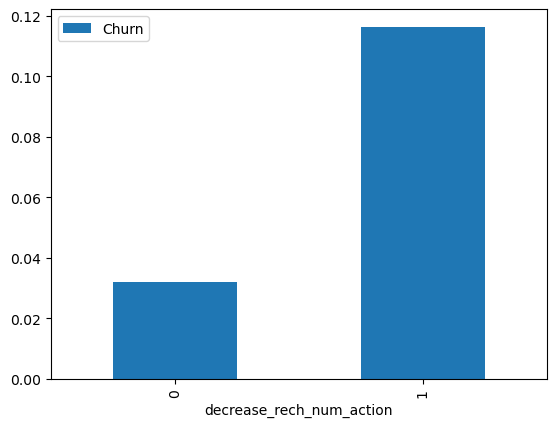

Plotting  decrease_mou_action


<Figure size 200x200 with 0 Axes>

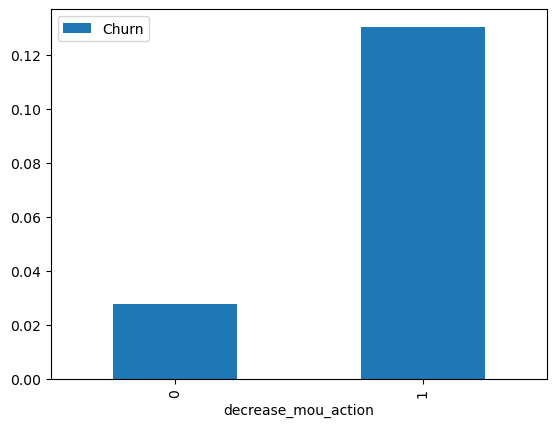

Plotting  decrease_arpu


<Figure size 200x200 with 0 Axes>

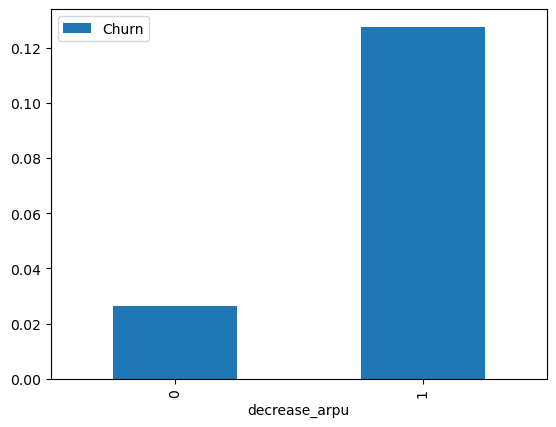

Plotting  decrease_vbc


<Figure size 200x200 with 0 Axes>

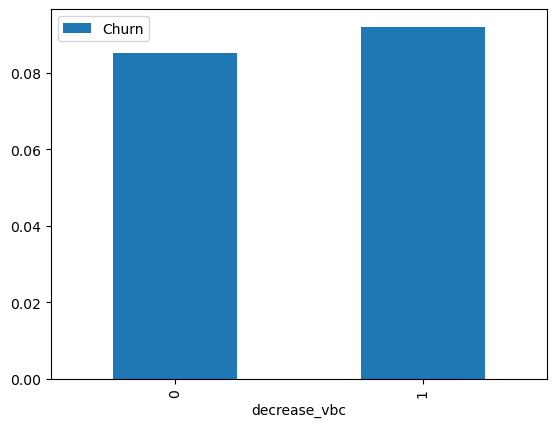

In [55]:
for i in col_list:
    print("Plotting ", i)
    displayplot(i)

##### As can be seen from the above charts the churn rate is more for the customers whose rech_num,mou(minutes of usage),arpu(average renenue per user),vbc(volume based cost) have decreased in action phase as compared to the good phase

In [56]:
#Now let us delete the _decrease columns created since we no longer need them for model prediction
data_HVC=data_HVC.drop(col_list,axis=1)

In [57]:
data_HVC.shape

(30011, 43)

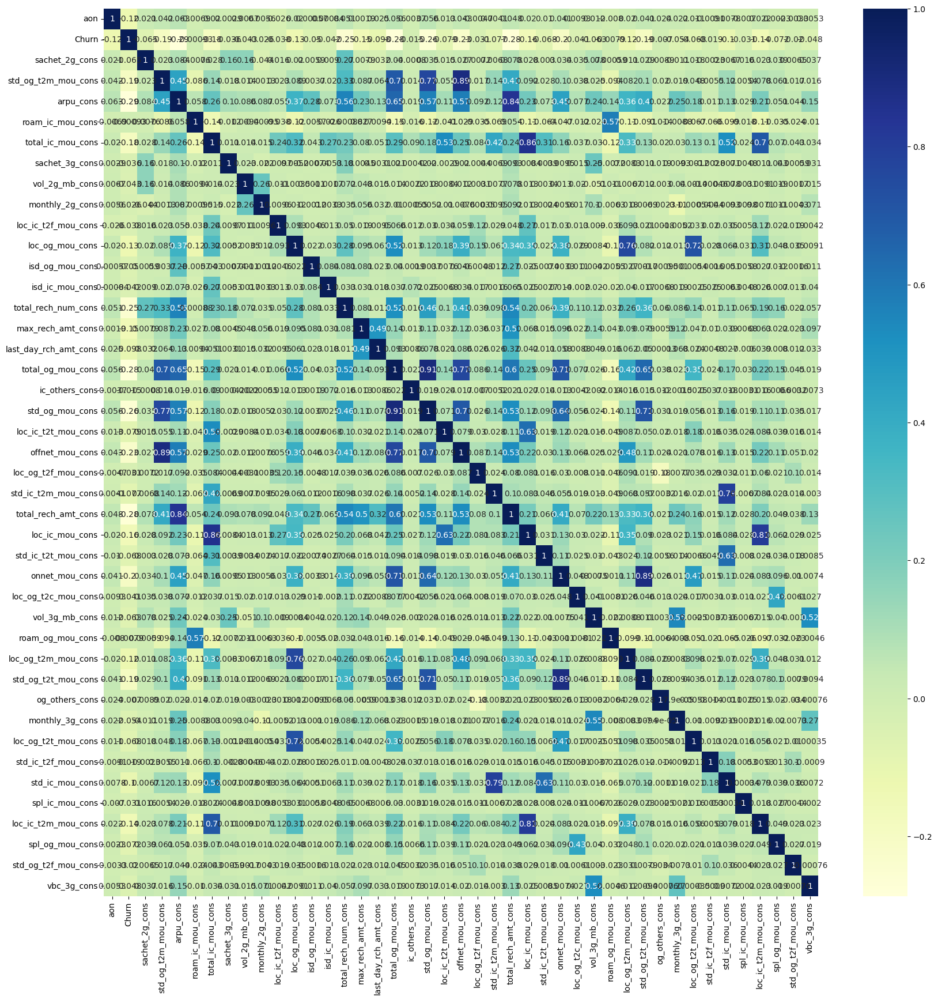

In [58]:
#Let us plot a heat-map to check the correlation between the variables.
plt.figure(figsize=(20,20))
sns.heatmap(data_HVC.corr(), annot = True, cmap = 'YlGnBu')
plt.show()

##### As can be seen above there are correlated variables present like
- arpu_const and total_rech_amt_cons
- total_og_mou_cons and std_og_mou_cons
- loc_og_mou_cons and loc_og_t2m_mou_cons

##### Analysis of Recharge Amount and the number of Recharge 

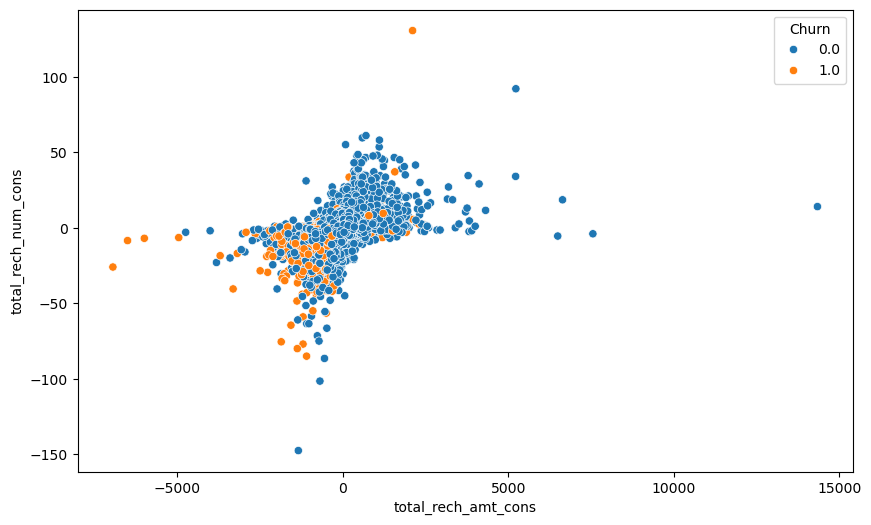

In [59]:
plt.figure(figsize=(10,6))
ax = sns.scatterplot(x='total_rech_amt_cons',y='total_rech_num_cons', hue='Churn', data=data_HVC)

##### As can be seen above the recharge number and the recharge amount are mostly propotional. More the number of recharge, more the amount of the recharge.

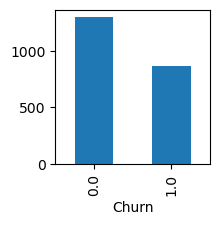

In [60]:
# Plotting AON(Age on network) to understand their relationship/impact with/on churn
plt.figure(figsize=(2,2))
data_HVC.groupby(['Churn'])['aon'].mean().plot.bar()
plt.show()

#### From the plots drawn in the Univariate and Bi-variate analysis we can infer that
- There is a significant drop in the  
    - Recharge Numbers 
    - Minutes of usage(MOU)
    - Average Revenue per user(ARPU) 
for the churn customers in the "action" phase (month Aug in our case) just before they leave the operator
- There is a slight drop in the Volume Based Cost(VBC) in the action phase
- The churned customers had less number of association year with the operator. So newer customers are churning more

### Step7: Handling the class Imbalance

##### Splitting the data into train and test

In [61]:
# Create Train and Test Sets
from sklearn.model_selection import train_test_split
y = data_HVC.Churn
X = data_HVC.drop('Churn', axis=1)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify = y, random_state=56)

##### Scaling the data

In [62]:
# Inspecting the data before scaling
X_train.head()

,aon,sachet_2g_cons,std_og_t2m_mou_cons,arpu_cons,roam_ic_mou_cons,total_ic_mou_cons,sachet_3g_cons,vol_2g_mb_cons,monthly_2g_cons,loc_ic_t2f_mou_cons,...,og_others_cons,monthly_3g_cons,loc_og_t2t_mou_cons,std_ic_t2f_mou_cons,std_ic_mou_cons,spl_ic_mou_cons,loc_ic_t2m_mou_cons,spl_og_mou_cons,std_og_t2f_mou_cons,vbc_3g_cons
80210,1175,0.0,-6.410,-163.2605,0.000,-40.165,0.0,0.00,0.0,-0.390,...,0.0,0.0,-50.745,0.0,-2.935,0.000,-110.380,-2.775,0.0,0.00
46267,1207,1.0,-127.055,-615.8750,0.000,-141.340,0.0,0.05,0.0,-1.345,...,0.0,0.0,-104.425,0.0,-22.365,0.000,-79.540,1.160,0.0,0.00
31408,2008,0.0,-75.710,-96.6845,0.000,-115.590,0.0,0.00,0.0,-14.820,...,0.0,0.0,-8.140,0.0,-2.745,0.000,-97.345,0.000,0.0,0.00
34898,3138,0.0,5.805,-238.5270,-43.665,81.140,0.0,0.00,0.0,27.695,...,0.0,0.0,-3.195,0.0,-1.385,0.000,-3.280,5.650,0.0,-24.24
62610,840,0.0,-0.620,-387.3355,0.000,-65.440,0.0,-17.92,0.0,-0.115,...,0.0,-1.0,-14.160,0.0,2.530,-0.205,-61.245,-0.005,0.0,-488.59


In [63]:
# Scaling X using standard scaler
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
cols=X_train.columns
X_train[cols] = scaler.fit_transform(X_train[cols])
X_train.head()

,aon,sachet_2g_cons,std_og_t2m_mou_cons,arpu_cons,roam_ic_mou_cons,total_ic_mou_cons,sachet_3g_cons,vol_2g_mb_cons,monthly_2g_cons,loc_ic_t2f_mou_cons,...,og_others_cons,monthly_3g_cons,loc_og_t2t_mou_cons,std_ic_t2f_mou_cons,std_ic_mou_cons,spl_ic_mou_cons,loc_ic_t2m_mou_cons,spl_og_mou_cons,std_og_t2f_mou_cons,vbc_3g_cons
80210,-0.094253,-0.047901,0.076530,-0.331328,0.030925,-0.111705,0.001159,0.044959,0.049031,0.030964,...,0.088233,0.015244,-0.296323,0.011855,0.000979,0.079744,-0.752088,-0.157464,0.023286,-0.001216
46267,-0.061456,0.652346,-0.317531,-1.690843,0.030925,-0.551963,0.001159,0.045192,0.049031,-0.002540,...,0.088233,0.015244,-0.667386,0.011855,-0.181043,0.079744,-0.529182,0.043708,0.023286,-0.001216
31408,0.759473,-0.047901,-0.149824,-0.131354,0.030925,-0.439913,0.001159,0.044959,0.049031,-0.475278,...,0.088233,0.015244,-0.001815,0.011855,0.002758,0.079744,-0.657873,-0.015596,0.023286,-0.001216
34898,1.917588,-0.047901,0.116427,-0.557405,-0.637902,0.416148,0.001159,0.044959,0.049031,1.016259,...,0.088233,0.015244,0.032367,0.011855,0.015499,0.079744,0.022010,0.273254,0.023286,-0.088712
62610,-0.437588,-0.047901,0.095441,-1.004381,0.030925,-0.221688,0.001159,-0.038571,0.049031,0.040612,...,0.088233,-2.231982,-0.043428,0.011855,0.052175,-0.978112,-0.396950,-0.015851,0.023286,-1.764821


In [64]:
# Scaling the test data
X_test[cols]=scaler.transform(X_test[cols])
X_test.head()

,aon,sachet_2g_cons,std_og_t2m_mou_cons,arpu_cons,roam_ic_mou_cons,total_ic_mou_cons,sachet_3g_cons,vol_2g_mb_cons,monthly_2g_cons,loc_ic_t2f_mou_cons,...,og_others_cons,monthly_3g_cons,loc_og_t2t_mou_cons,std_ic_t2f_mou_cons,std_ic_mou_cons,spl_ic_mou_cons,loc_ic_t2m_mou_cons,spl_og_mou_cons,std_og_t2f_mou_cons,vbc_3g_cons
34193,0.402815,-0.047901,0.545045,0.315963,-2.905774,0.762480,0.001159,0.044959,0.049031,-0.084984,...,0.088233,0.015244,0.153302,0.011855,1.123319,0.079744,0.292944,-0.015596,0.023286,-0.001216
86836,-0.913132,1.702716,0.161861,0.233483,0.030925,0.582069,0.001159,0.311911,0.049031,0.306889,...,0.088233,0.015244,0.321241,-0.138478,0.058030,-0.591091,0.421093,-0.285018,0.023286,-0.001216
80744,-0.267457,-0.047901,0.243633,0.923410,0.030925,0.087744,0.001159,0.044959,0.049031,0.044646,...,0.088233,0.015244,0.066619,0.011855,0.055126,0.079744,0.058221,-0.021475,0.023286,-0.001216
2754,0.845563,-0.047901,0.168769,-0.220951,0.030925,0.481833,0.001159,0.044959,0.049031,0.044646,...,0.088233,0.015244,0.356564,0.011855,0.042385,0.079744,0.667055,0.111447,0.023286,-0.001216
92633,1.089485,-0.047901,0.211198,0.206101,0.226986,-0.271338,0.001159,0.044959,0.049031,0.518261,...,0.088233,0.015244,0.051169,-0.003826,-0.149098,0.079744,-0.225868,-1.205757,0.023286,-0.001216


In [65]:
X_train.shape

(21007, 42)

In [66]:
X_test.shape

(9004, 42)

In [67]:
print(y_train.value_counts())
y_train.value_counts(normalize = True).reset_index()

Churn
0.0    19192
1.0     1815
Name: count, dtype: int64


,Churn,proportion
0,0.0,0.9136
1,1.0,0.0864


In [68]:
print(y_test.value_counts())
y_test.value_counts(normalize = True).reset_index()

Churn
0.0    8226
1.0     778
Name: count, dtype: int64


,Churn,proportion
0,0.0,0.913594
1,1.0,0.086406


##### Evaluation Metrics
In this problem we will use recall as evaluation metric because we would like to capture the performace where we will be rightly predicting positive classes.

In [69]:
# Logistic Regression
from collections import Counter
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report, accuracy_score, f1_score

In [70]:
lreg = LogisticRegression()
lreg.fit(X_train, y_train)

LogisticRegression()

In [71]:
y_pred = lreg.predict(X_test)

In [72]:
print ('Accuracy: ', accuracy_score(y_test, y_pred))
print ('F1 score: ', f1_score(y_test, y_pred))
print ('Recall: ', recall_score(y_test, y_pred))
print ('Precision: ', precision_score(y_test, y_pred))
print ('\n clasification report:\n', classification_report(y_test,y_pred))
print ('\n confussion matrix:\n',confusion_matrix(y_test, y_pred))

Accuracy:  0.9175921812527765
F1 score:  0.23029045643153526
Recall:  0.14267352185089974
Precision:  0.5967741935483871

 clasification report:
               precision    recall  f1-score   support

         0.0       0.92      0.99      0.96      8226
         1.0       0.60      0.14      0.23       778

    accuracy                           0.92      9004
   macro avg       0.76      0.57      0.59      9004
weighted avg       0.90      0.92      0.89      9004


 confussion matrix:
 [[8151   75]
 [ 667  111]]


#### As you can see above the Recall % is only 14%. Let us now do the handling for the class imbalance and check the metrics performance again

In [73]:
# SMOTE
from imblearn.over_sampling import SMOTE
smt = SMOTE(random_state=45, k_neighbors=5)
X_train, y_train = smt.fit_resample(X_train, y_train)
len(X_train)

38384

In [74]:
print(sorted(Counter(y_train).items()))

[(0.0, 19192), (1.0, 19192)]


In [75]:
lreg_smt = LogisticRegression()
lreg_smt.fit(X_train, y_train)

y_pred_smt = lreg_smt.predict(X_test)

In [76]:
print ('Accuracy: ', accuracy_score(y_test, y_pred_smt))
print ('F1 score: ', f1_score(y_test, y_pred_smt))
print ('Recall: ', recall_score(y_test, y_pred_smt))
print ('Precision: ', precision_score(y_test, y_pred_smt))
print ('\n clasification report:\n', classification_report(y_test,y_pred_smt))
print ('\n confussion matrix:\n',confusion_matrix(y_test, y_pred_smt))

Accuracy:  0.8008662816525989
F1 score:  0.3997321727485772
Recall:  0.7673521850899743
Precision:  0.27025803531009507

 clasification report:
               precision    recall  f1-score   support

         0.0       0.97      0.80      0.88      8226
         1.0       0.27      0.77      0.40       778

    accuracy                           0.80      9004
   macro avg       0.62      0.79      0.64      9004
weighted avg       0.91      0.80      0.84      9004


 confussion matrix:
 [[6614 1612]
 [ 181  597]]


##### As you can see above the recall metrcis has increased to 76% after hndling the class imbalance

### Step 8:Build models to predict churn

#### Step 8.1:Logistic Regression using RFE

In [77]:
# Feature selection using RFE
X_train.shape

(38384, 42)

##### Let us use RFECV to determine the optimal number of features to select

In [78]:
from sklearn.feature_selection import RFECV

In [79]:
logreg = LogisticRegression(random_state=42)

In [80]:
rfecv = RFECV(estimator=logreg, cv=4)

In [81]:
%%time
rfecv.fit(X_train, y_train)

CPU times: total: 1min 22s
Wall time: 42 s


RFECV(cv=4, estimator=LogisticRegression(random_state=42))

In [82]:
rfecv.cv_results_

{'mean_test_score': array([0.76187995, 0.77818883, 0.77641726, 0.77860567, 0.78102855,
        0.78376407, 0.78485827, 0.78683827, 0.78767195, 0.78827115,
        0.79092851, 0.7902772 , 0.79074614, 0.79118904, 0.79006878,
        0.78939141, 0.78933931, 0.78959983, 0.78946957, 0.78959983,
        0.78949562, 0.78952168, 0.78962589, 0.78936536, 0.78952168,
        0.78941747, 0.78959983, 0.78944352, 0.7892351 , 0.78910484,
        0.78915694, 0.78926115, 0.78939141, 0.78965194, 0.78946957,
        0.78957378, 0.78941747, 0.78949562, 0.78944352, 0.78946957,
        0.78944352, 0.78946957]),
 'std_test_score': array([0.00094654, 0.00199025, 0.00376132, 0.00173518, 0.00349483,
        0.00495902, 0.00389535, 0.00168114, 0.00278116, 0.0038855 ,
        0.00239159, 0.00206128, 0.00132228, 0.00148728, 0.00234241,
        0.00210623, 0.00210816, 0.00226642, 0.00218142, 0.00188876,
        0.00192295, 0.00169061, 0.00178436, 0.00226207, 0.00226567,
        0.00285236, 0.00261669, 0.00261825, 0

In [83]:
rfecv.cv_results_['mean_test_score']

array([0.76187995, 0.77818883, 0.77641726, 0.77860567, 0.78102855,
       0.78376407, 0.78485827, 0.78683827, 0.78767195, 0.78827115,
       0.79092851, 0.7902772 , 0.79074614, 0.79118904, 0.79006878,
       0.78939141, 0.78933931, 0.78959983, 0.78946957, 0.78959983,
       0.78949562, 0.78952168, 0.78962589, 0.78936536, 0.78952168,
       0.78941747, 0.78959983, 0.78944352, 0.7892351 , 0.78910484,
       0.78915694, 0.78926115, 0.78939141, 0.78965194, 0.78946957,
       0.78957378, 0.78941747, 0.78949562, 0.78944352, 0.78946957,
       0.78944352, 0.78946957])

In [84]:
num_features = X_train.shape
num_features[1]

42

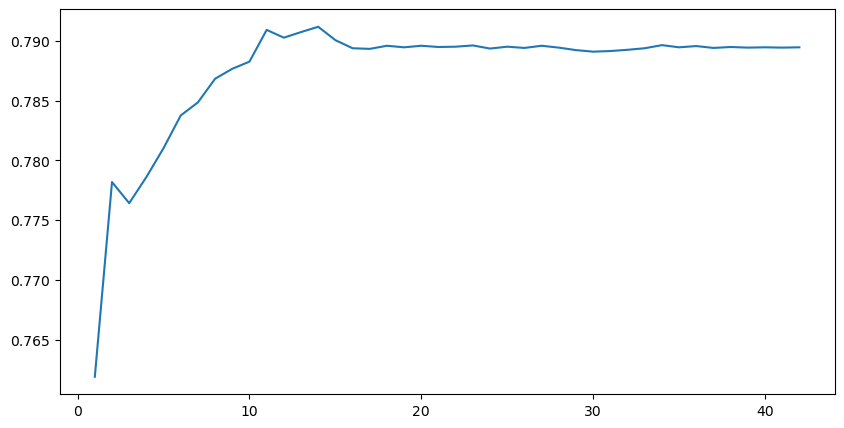

In [85]:
plt.figure(figsize=[10, 5])
# plt.plot(range(1, num_features[1]+1), rfecv.grid_scores_)
plt.plot(range(1, num_features[1]+1), rfecv.cv_results_['mean_test_score'])
plt.show()

In [86]:
rfecv.n_features_

14

##### As seen above RFECV has suggested the optimal number of features as 14 , hence let us use rounded value of 15 for column selection

In [87]:
# Running the RFE model
from sklearn.feature_selection import RFE
logreg = LogisticRegression()
rfe = RFE(logreg, n_features_to_select=15)             # running RFE with 15 variables as output
rfe = rfe.fit(X_train, y_train)

In [88]:
# storing the RFE output
col = X_train.columns[rfe.support_]

In [89]:
# Doing a logistic regression on the training dataset
import statsmodels.api as sm

X_train_sm = sm.add_constant(X_train[col])
logm1 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm1.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                  Churn   No. Observations:                38384
Model:                            GLM   Df Residuals:                    38368
Model Family:                Binomial   Df Model:                           15
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -19365.
Date:                Mon, 02 Dec 2024   Deviance:                       38730.
Time:                        09:30:13   Pearson chi2:                 2.49e+10
No. Iterations:                     7   Pseudo R-squ. (CS):             0.3143
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.7447      0.015    -50.759      0.000      -0.773      -0.716
aon                      -0.4848      0.015    -31.968      0.000      -0.514      -0.455
arpu_cons                -0.5281      0.025    -20.938      0.000      -0.578      -0.479
total_ic_mou_cons        -0.3595      0.025    -14.189      0.000      -0.409      -0.310
total_rech_num_cons      -0.3273      0.018    -17.854      0.000      -0.363      -0.291
max_rech_amt_cons        -0.2435      0.016    -15.483      0.000      -0.274      -0.213
last_day_rch_amt_cons    -0.2277      0.019    -12.277      0.000      -0.264      -0.191
total_og_mou_cons         3.0391      0.403      7.548      0.000       2.250       3.828
std_og_mou_cons          -3.0375      0.340     -8.937      0.000      -3.704      -2.371
onnet_mou_cons            0.7453      0.079      9.450      0.000       0.591       0.900
loc_og_t2m_mou_cons      -0.8538      0.120     -7.099      0.000      -1.090      -0.618
std_og_t2t_mou_cons      -0.6423      0.073     -8.768      0.000      -0.786      -0.499
og_others_cons            0.2172      0.040      5.469      0.000       0.139       0.295
loc_og_t2t_mou_cons      -1.1912      0.122     -9.799      0.000      -1.429      -0.953
loc_ic_t2m_mou_cons      -0.1451      0.027     -5.315      0.000      -0.199      -0.092
spl_og_mou_cons          -0.2184      0.025     -8.895      0.000      -0.266      -0.170
=========================================================================================
"""

In [90]:
# Create a dataframe that will contain the names of all the feature variables and their respective VIFs
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
6,total_og_mou_cons,824.77
7,std_og_mou_cons,622.54
8,onnet_mou_cons,52.78
9,loc_og_t2m_mou_cons,47.93
10,std_og_t2t_mou_cons,47.73
12,loc_og_t2t_mou_cons,40.27
1,arpu_cons,3.90
13,loc_ic_t2m_mou_cons,2.71
2,total_ic_mou_cons,2.61
3,total_rech_num_cons,1.98


In [91]:
# Removing 'total_og_mou_cons' column since it has a very high VIF
col=col.drop('total_og_mou_cons')

In [92]:
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm2 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                  Churn   No. Observations:                38384
Model:                            GLM   Df Residuals:                    38369
Model Family:                Binomial   Df Model:                           14
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -19388.
Date:                Mon, 02 Dec 2024   Deviance:                       38776.
Time:                        09:30:14   Pearson chi2:                 8.27e+09
No. Iterations:                     7   Pseudo R-squ. (CS):             0.3135
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.7408      0.015    -50.586      0.000      -0.770      -0.712
aon                      -0.4878      0.015    -32.166      0.000      -0.518      -0.458
arpu_cons                -0.4898      0.025    -19.855      0.000      -0.538      -0.441
total_ic_mou_cons        -0.3497      0.025    -13.904      0.000      -0.399      -0.300
total_rech_num_cons      -0.3326      0.018    -18.138      0.000      -0.368      -0.297
max_rech_amt_cons        -0.2399      0.016    -15.137      0.000      -0.271      -0.209
last_day_rch_amt_cons    -0.2309      0.019    -12.408      0.000      -0.267      -0.194
std_og_mou_cons          -0.4734      0.027    -17.848      0.000      -0.525      -0.421
onnet_mou_cons            0.6921      0.078      8.930      0.000       0.540       0.844
loc_og_t2m_mou_cons       0.0451      0.018      2.556      0.011       0.011       0.080
std_og_t2t_mou_cons      -0.5953      0.072     -8.253      0.000      -0.737      -0.454
og_others_cons            0.2264      0.043      5.261      0.000       0.142       0.311
loc_og_t2t_mou_cons      -0.3242      0.037     -8.844      0.000      -0.396      -0.252
loc_ic_t2m_mou_cons      -0.1473      0.027     -5.424      0.000      -0.201      -0.094
spl_og_mou_cons          -0.1039      0.019     -5.375      0.000      -0.142      -0.066
=========================================================================================
"""

In [93]:
#Let us check the VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
7,onnet_mou_cons,51.28
9,std_og_t2t_mou_cons,46.40
11,loc_og_t2t_mou_cons,5.91
6,std_og_mou_cons,3.26
1,arpu_cons,2.94
12,loc_ic_t2m_mou_cons,2.71
2,total_ic_mou_cons,2.61
3,total_rech_num_cons,1.96
4,max_rech_amt_cons,1.57
8,loc_og_t2m_mou_cons,1.53


In [94]:
# Removing 'onnet_mou_cons' column since it has a veru high VIF
col=col.drop('onnet_mou_cons')

In [95]:
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm3 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm3.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                  Churn   No. Observations:                38384
Model:                            GLM   Df Residuals:                    38370
Model Family:                Binomial   Df Model:                           13
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -19430.
Date:                Mon, 02 Dec 2024   Deviance:                       38861.
Time:                        09:30:15   Pearson chi2:                 8.21e+09
No. Iterations:                     7   Pseudo R-squ. (CS):             0.3119
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.7334      0.015    -50.288      0.000      -0.762      -0.705
aon                      -0.4840      0.015    -32.018      0.000      -0.514      -0.454
arpu_cons                -0.4128      0.023    -18.040      0.000      -0.458      -0.368
total_ic_mou_cons        -0.3607      0.025    -14.282      0.000      -0.410      -0.311
total_rech_num_cons      -0.3304      0.018    -18.114      0.000      -0.366      -0.295
max_rech_amt_cons        -0.2416      0.016    -15.309      0.000      -0.273      -0.211
last_day_rch_amt_cons    -0.2307      0.019    -12.450      0.000      -0.267      -0.194
std_og_mou_cons          -0.5226      0.026    -20.115      0.000      -0.573      -0.472
loc_og_t2m_mou_cons       0.0195      0.017      1.115      0.265      -0.015       0.054
std_og_t2t_mou_cons       0.0157      0.023      0.687      0.492      -0.029       0.061
og_others_cons            0.2262      0.043      5.271      0.000       0.142       0.310
loc_og_t2t_mou_cons      -0.0273      0.015     -1.766      0.077      -0.058       0.003
loc_ic_t2m_mou_cons      -0.1504      0.027     -5.518      0.000      -0.204      -0.097
spl_og_mou_cons          -0.1097      0.019     -5.652      0.000      -0.148      -0.072
=========================================================================================
"""

In [96]:
# Let us check the VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
6,std_og_mou_cons,3.15
1,arpu_cons,2.75
11,loc_ic_t2m_mou_cons,2.71
2,total_ic_mou_cons,2.61
8,std_og_t2t_mou_cons,2.32
3,total_rech_num_cons,1.96
4,max_rech_amt_cons,1.57
7,loc_og_t2m_mou_cons,1.51
5,last_day_rch_amt_cons,1.43
0,aon,1.08


In [97]:
# Removing 'std_og_t2t_mou_cons' since it has a high p-value
col=col.drop('std_og_t2t_mou_cons')

In [98]:
# Let's re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm4 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm4.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                  Churn   No. Observations:                38384
Model:                            GLM   Df Residuals:                    38371
Model Family:                Binomial   Df Model:                           12
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -19431.
Date:                Mon, 02 Dec 2024   Deviance:                       38861.
Time:                        09:30:16   Pearson chi2:                 8.42e+09
No. Iterations:                     7   Pseudo R-squ. (CS):             0.3119
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.7335      0.015    -50.292      0.000      -0.762      -0.705
aon                      -0.4840      0.015    -32.019      0.000      -0.514      -0.454
arpu_cons                -0.4128      0.023    -18.040      0.000      -0.458      -0.368
total_ic_mou_cons        -0.3606      0.025    -14.276      0.000      -0.410      -0.311
total_rech_num_cons      -0.3304      0.018    -18.116      0.000      -0.366      -0.295
max_rech_amt_cons        -0.2414      0.016    -15.299      0.000      -0.272      -0.210
last_day_rch_amt_cons    -0.2310      0.019    -12.467      0.000      -0.267      -0.195
std_og_mou_cons          -0.5107      0.019    -26.481      0.000      -0.548      -0.473
loc_og_t2m_mou_cons       0.0194      0.017      1.108      0.268      -0.015       0.054
og_others_cons            0.2264      0.043      5.277      0.000       0.142       0.311
loc_og_t2t_mou_cons      -0.0274      0.015     -1.769      0.077      -0.058       0.003
loc_ic_t2m_mou_cons      -0.1507      0.027     -5.530      0.000      -0.204      -0.097
spl_og_mou_cons          -0.1094      0.019     -5.638      0.000      -0.147      -0.071
=========================================================================================
"""

In [99]:
# Let us check the VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
1,arpu_cons,2.75
10,loc_ic_t2m_mou_cons,2.71
2,total_ic_mou_cons,2.61
3,total_rech_num_cons,1.96
6,std_og_mou_cons,1.85
4,max_rech_amt_cons,1.57
7,loc_og_t2m_mou_cons,1.51
5,last_day_rch_amt_cons,1.43
0,aon,1.08
9,loc_og_t2t_mou_cons,1.08


In [100]:
# Removing 'loc_og_t2m_mou_cons' since it has a high p-value
col=col.drop('loc_og_t2m_mou_cons')

In [101]:
#Let us re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm5 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm5.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                  Churn   No. Observations:                38384
Model:                            GLM   Df Residuals:                    38372
Model Family:                Binomial   Df Model:                           11
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -19431.
Date:                Mon, 02 Dec 2024   Deviance:                       38862.
Time:                        09:30:17   Pearson chi2:                 8.93e+09
No. Iterations:                     7   Pseudo R-squ. (CS):             0.3119
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.7335      0.015    -50.292      0.000      -0.762      -0.705
aon                      -0.4847      0.015    -32.077      0.000      -0.514      -0.455
arpu_cons                -0.4063      0.022    -18.392      0.000      -0.450      -0.363
total_ic_mou_cons        -0.3598      0.025    -14.266      0.000      -0.409      -0.310
total_rech_num_cons      -0.3295      0.018    -18.091      0.000      -0.365      -0.294
max_rech_amt_cons        -0.2421      0.016    -15.353      0.000      -0.273      -0.211
last_day_rch_amt_cons    -0.2308      0.019    -12.456      0.000      -0.267      -0.194
std_og_mou_cons          -0.5138      0.019    -26.926      0.000      -0.551      -0.476
og_others_cons            0.2273      0.043      5.295      0.000       0.143       0.311
loc_og_t2t_mou_cons      -0.0273      0.015     -1.761      0.078      -0.058       0.003
loc_ic_t2m_mou_cons      -0.1427      0.026     -5.446      0.000      -0.194      -0.091
spl_og_mou_cons          -0.1090      0.019     -5.621      0.000      -0.147      -0.071
=========================================================================================
"""

In [102]:
#Let us check the VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
1,arpu_cons,2.61
2,total_ic_mou_cons,2.61
9,loc_ic_t2m_mou_cons,2.48
3,total_rech_num_cons,1.93
6,std_og_mou_cons,1.80
4,max_rech_amt_cons,1.57
5,last_day_rch_amt_cons,1.43
0,aon,1.08
8,loc_og_t2t_mou_cons,1.07
10,spl_og_mou_cons,1.07


In [103]:
# Removing 'loc_og_t2t_mou_cons' column since it has a high p-value
col=col.drop('loc_og_t2t_mou_cons')

In [104]:
#Let us re-run the model using the selected variables
X_train_sm = sm.add_constant(X_train[col])
logm6 = sm.GLM(y_train,X_train_sm, family = sm.families.Binomial())
res = logm6.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                  Churn   No. Observations:                38384
Model:                            GLM   Df Residuals:                    38373
Model Family:                Binomial   Df Model:                           10
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -19433.
Date:                Mon, 02 Dec 2024   Deviance:                       38866.
Time:                        09:30:17   Pearson chi2:                 6.46e+09
No. Iterations:                     7   Pseudo R-squ. (CS):             0.3119
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.7331      0.015    -50.281      0.000      -0.762      -0.705
aon                      -0.4844      0.015    -32.068      0.000      -0.514      -0.455
arpu_cons                -0.4109      0.022    -18.708      0.000      -0.454      -0.368
total_ic_mou_cons        -0.3647      0.025    -14.509      0.000      -0.414      -0.315
total_rech_num_cons      -0.3313      0.018    -18.203      0.000      -0.367      -0.296
max_rech_amt_cons        -0.2417      0.016    -15.329      0.000      -0.273      -0.211
last_day_rch_amt_cons    -0.2308      0.019    -12.455      0.000      -0.267      -0.195
std_og_mou_cons          -0.5107      0.019    -26.881      0.000      -0.548      -0.473
og_others_cons            0.2250      0.043      5.247      0.000       0.141       0.309
loc_ic_t2m_mou_cons      -0.1405      0.026     -5.362      0.000      -0.192      -0.089
spl_og_mou_cons          -0.1090      0.019     -5.622      0.000      -0.147      -0.071
=========================================================================================
"""

In [105]:
#Let us check the VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif['Features'] = X_train[col].columns
vif['VIF'] = [variance_inflation_factor(X_train[col].values, i) for i in range(X_train[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
1,arpu_cons,2.58
2,total_ic_mou_cons,2.58
8,loc_ic_t2m_mou_cons,2.48
3,total_rech_num_cons,1.93
6,std_og_mou_cons,1.79
4,max_rech_amt_cons,1.57
5,last_day_rch_amt_cons,1.43
0,aon,1.08
9,spl_og_mou_cons,1.07
7,og_others_cons,1.01


##### Since the VIF and p-value is within the accepatble limits we can take this as the final model and proceed to derive the Churn probability and make predictions

In [106]:
# Doing a logistic regression on the training dataset
import statsmodels.api as sm
from sklearn import metrics

# logreg = LogisticRegression()
# logm1 = logreg.fit(X_train[col], y_train)

y_train_pred = res.predict(X_train_sm)
y_train_pred = y_train_pred.values.reshape(-1)

#Creating a dataframe with the actual churn flag and the predicted probabilities
y_train_pred_final = pd.DataFrame({'Churn':y_train.values, 'Churn_Prob':y_train_pred})
y_train_pred_final['CustIndex'] = y_train.index

# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_train_pred_final['predicted'] = y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

print("Train Precision : {}".format(round(metrics.precision_score(y_train_pred_final.Churn, y_train_pred_final.predicted),2)))
print("Train Recall : {}".format(round(metrics.recall_score(y_train_pred_final.Churn, y_train_pred_final.predicted),2)))
print("Train Accuracy : {}".format(round(metrics.accuracy_score(y_train_pred_final.Churn, y_train_pred_final.predicted),2)))

# Confusion matrix 
confusion = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final.predicted )
print("Train Confusion Matrix \n", confusion)

Train Precision : 0.8
Train Recall : 0.78
Train Accuracy : 0.79
Train Confusion Matrix 
 [[15507  3685]
 [ 4275 14917]]


##### Our emphasis is to maximize the Recall since we want to correctly predict the True Positives
Hence we will plot the Precision-Recall curve to find the optimal cut-off threshold

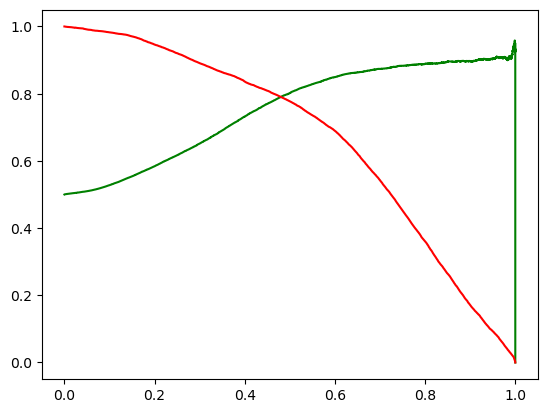

In [107]:
# Plotting a precision-Recall curve to find the optimal cutoff point
from sklearn.metrics import precision_recall_curve
p, r, thresholds = precision_recall_curve(y_train_pred_final.Churn, y_train_pred_final.Churn_Prob)
plt.plot(thresholds, p[:-1], "g-")
plt.plot(thresholds, r[:-1], "r-")
plt.show()

##### If we look at the above graph the optimal value is at 0.5

   Churn  Churn_Prob  CustIndex  predicted  0.0  0.1  0.2  0.3  0.4  0.5  0.6  \
0    0.0    0.410171          0          0    1    1    1    1    1    0    0   
1    0.0    0.678335          1          1    1    1    1    1    1    1    1   
2    0.0    0.317131          2          0    1    1    1    1    0    0    0   
3    0.0    0.278864          3          0    1    1    1    0    0    0    0   
4    0.0    0.634983          4          1    1    1    1    1    1    1    1   

   0.7  0.8  0.9  1.0  
0    0    0    0    0  
1    0    0    0    0  
2    0    0    0    0  
3    0    0    0    0  
4    0    0    0    0  
     prob  accuracy     sensi     speci
0.0   0.0  0.500000  1.000000  0.000000
0.1   0.1  0.551584  0.982493  0.120675
0.2   0.2  0.636098  0.946228  0.325969
0.3   0.3  0.707118  0.890684  0.523551
0.4   0.4  0.764824  0.835817  0.693831
0.5   0.5  0.792622  0.777251  0.807993
0.6   0.6  0.783504  0.689298  0.877709
0.7   0.7  0.731841  0.542049  0.921634
0.8   0.8

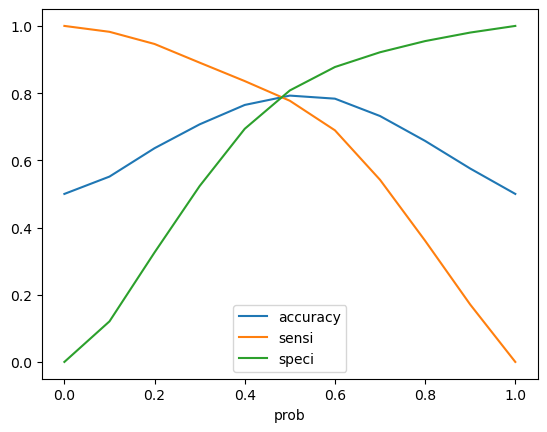

In [108]:
# We can also plot the specificity, sensitivity and accuracy graphs to revalidate the cutoff point
# Let's create columns with different probability cutoffs 
numbers = [float(x)/10 for x in range(11)]
for i in numbers:
    y_train_pred_final[i]= y_train_pred_final.Churn_Prob.map(lambda x: 1 if x > i else 0)
print(y_train_pred_final.head())

# Now let's calculate accuracy sensitivity and specificity for various probability cutoffs.
cutoff_df = pd.DataFrame( columns = ['prob','accuracy','sensi','speci'])
from sklearn.metrics import confusion_matrix

# TP = confusion[1,1] # true positive 
# TN = confusion[0,0] # true negatives
# FP = confusion[0,1] # false positives
# FN = confusion[1,0] # false negatives

num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9, 1]
for i in num:
    cm1 = metrics.confusion_matrix(y_train_pred_final.Churn, y_train_pred_final[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    speci = cm1[0,0]/(cm1[0,0]+cm1[0,1])
    sensi = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_df.loc[i] =[ i ,accuracy,sensi,speci]
print(cutoff_df)

# Let's plot accuracy sensitivity and specificity for various probabilities.
cutoff_df.plot.line(x='prob', y=['accuracy','sensi','speci'])
plt.show()

##### We get the same result of 0.5 as the cutoff point. So we will make predictions on the test dataset using this cutoff value

In [109]:
# X_test = X_test[col]
X_test_sm = sm.add_constant(X_test[col])
y_test_pred = res.predict(X_test_sm)

#Creating a dataframe with the actual churn flag and the predicted probabilities
y_test_pred_final = pd.DataFrame({'Churn':y_test.values, 'Churn_Prob':y_test_pred})
y_test_pred_final['CustIndex'] = y_test.index

# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_test_pred_final['predicted'] = y_test_pred_final.Churn_Prob.map(lambda x: 1 if x > 0.5 else 0)

print("Test Precision : {}".format(round(metrics.precision_score(y_test_pred_final.Churn, y_test_pred_final.predicted),2)))
print("Test Recall : {}".format(round(metrics.recall_score(y_test_pred_final.Churn, y_test_pred_final.predicted),2)))
print("Test Accuracy : {}".format(round(metrics.accuracy_score(y_test_pred_final.Churn, y_test_pred_final.predicted),2)))

# Confusion matrix 
confusion = metrics.confusion_matrix(y_test_pred_final.Churn, y_test_pred_final.predicted )
print("Test Confusion Matrix \n", confusion)

Test Precision : 0.27
Test Recall : 0.77
Test Accuracy : 0.8
Test Confusion Matrix 
 [[6623 1603]
 [ 178  600]]


In [110]:
# inspecting the final test predicted dataset with churn probability and predicted churn based on cutoff
y_test_pred_final

,Churn,Churn_Prob,CustIndex,predicted
34193,0.0,0.150660,34193,0
86836,0.0,0.269399,86836,0
80744,0.0,0.079252,80744,0
2754,0.0,0.327904,2754,0
92633,0.0,0.406161,92633,0
...,...,...,...,...
18818,0.0,0.628093,18818,1
26991,0.0,0.102850,26991,0
62336,1.0,0.589692,62336,1
29314,0.0,0.222067,29314,0


In [111]:
# Identifying the features that have most impact
pd.options.display.float_format = '{:.2f}'.format
new_params = res.params[1:]
new_params

aon                     -0.48
arpu_cons               -0.41
total_ic_mou_cons       -0.36
total_rech_num_cons     -0.33
max_rech_amt_cons       -0.24
last_day_rch_amt_cons   -0.23
std_og_mou_cons         -0.51
og_others_cons           0.22
loc_ic_t2m_mou_cons     -0.14
spl_og_mou_cons         -0.11
dtype: float64

In [112]:
# Getting a relative coeffient value for all the features wrt the feature with the highest coefficient

feature_importance = new_params
feature_importance = 100.0 * (feature_importance / feature_importance.max())
feature_importance

aon                     -215.31
arpu_cons               -182.61
total_ic_mou_cons       -162.11
total_rech_num_cons     -147.23
max_rech_amt_cons       -107.42
last_day_rch_amt_cons   -102.60
std_og_mou_cons         -226.99
og_others_cons           100.00
loc_ic_t2m_mou_cons      -62.46
spl_og_mou_cons          -48.44
dtype: float64

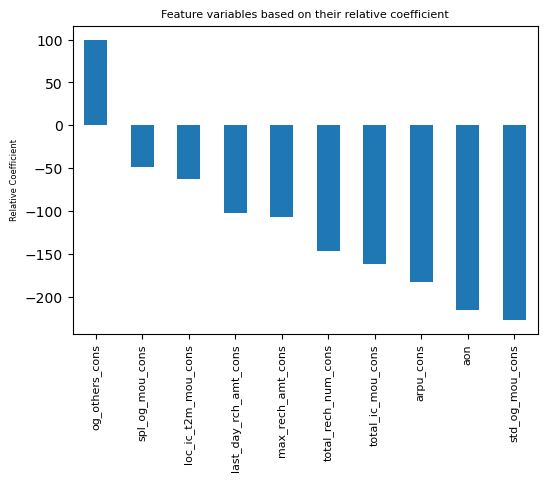

In [113]:
# Plot showing the feature variables based on their relative coefficient values
plt.figure(figsize = (6,4))
feature_importance.sort_values(ascending=False).plot(kind='bar')
plt.title('Feature variables based on their relative coefficient',fontsize=8)
plt.ylabel('Relative Coefficient',fontsize=6)
plt.xticks(fontsize=8)
plt.show()

##### Selecting Top features which contribute most towards the customer getting churned

In [114]:
# First let us convert into a dataframe
feature_ranking = pd.DataFrame(feature_importance)
feature_ranking.head()

,0
aon,-215.31
arpu_cons,-182.61
total_ic_mou_cons,-162.11
total_rech_num_cons,-147.23
max_rech_amt_cons,-107.42


In [115]:
#Let us select the Top 3 features that contribute most towards the probability of the customer getting churned
feature_ranking.sort_values(by=0,ascending=False).head(3)

,0
og_others_cons,100.00
spl_og_mou_cons,-48.44
loc_ic_t2m_mou_cons,-62.46


In [116]:
#Let us select the Bottom 3 features towards the probability of the customer getting churned
feature_ranking.sort_values(by=0,ascending=True).head(3)

,0
std_og_mou_cons,-226.99
aon,-215.31
arpu_cons,-182.61


In [117]:
# Plotting the ROC curve to determine the Area Under Curve (AUC)
def draw_roc( actual, probs ):
    fpr, tpr, thresholds = metrics.roc_curve( actual, probs,
                                              drop_intermediate = False )
    auc_score = metrics.roc_auc_score( actual, probs )
    plt.figure(figsize=(6, 6))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

    return fpr, tpr, thresholds

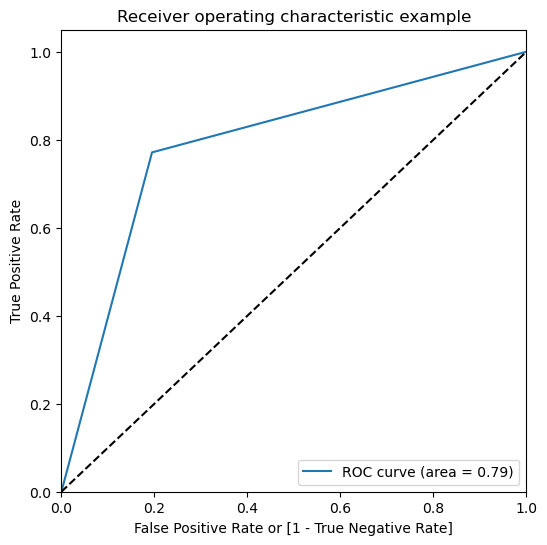

(array([0.        , 0.19486992, 1.        ]),
 array([0.        , 0.77120823, 1.        ]),
 array([inf,  1.,  0.]))

In [118]:
draw_roc(y_test_pred_final.Churn, y_test_pred_final.predicted)

#### Step 8.2:Decision Trees
##### Step 8.2.1: With default parameters except Depth

In [119]:
# Fitting the decision tree with default hyperparameters, apart from max_depth which is 5 to start with
from sklearn.tree import DecisionTreeClassifier
dt = DecisionTreeClassifier(max_depth=5)
dt.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=5)

In [120]:
# Importing required packages for visualization
from IPython.display import Image  
from six import StringIO  
from sklearn.tree import export_graphviz
import pydotplus, graphviz

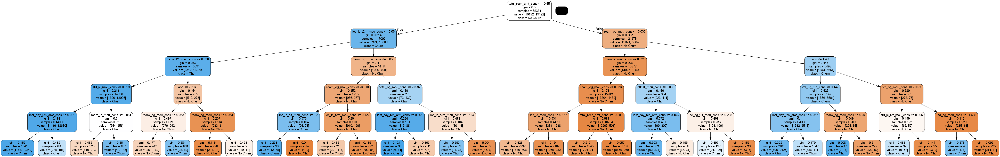

In [121]:
# plotting tree
dot_data = StringIO()  

export_graphviz(dt, out_file=dot_data, filled=True, rounded=True,
                feature_names=X.columns, 
                class_names=['No Churn', "Churn"])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

In [122]:
# Evaluating model performance
y_train_pred = dt.predict(X_train)
y_test_pred = dt.predict(X_test)

In [123]:
from sklearn.metrics import confusion_matrix, accuracy_score

In [124]:
print(accuracy_score(y_train, y_train_pred))
confusion_matrix(y_train, y_train_pred)

0.8635108378491038


array([[16104,  3088],
       [ 2151, 17041]], dtype=int64)

In [125]:
print(accuracy_score(y_test, y_test_pred))
confusion_matrix(y_test, y_test_pred)

0.8360728565082186


array([[6910, 1316],
       [ 160,  618]], dtype=int64)

In [126]:
# Printing out all accuracies
print("Precision : {}".format(round(metrics.precision_score(y_test, y_test_pred),2)))
print("Recall : {}".format(round(metrics.recall_score(y_test, y_test_pred),2)))
print("Accuracy : {}".format(round(metrics.accuracy_score(y_test, y_test_pred),2)))
print("ROC-AUC Score : {}".format(round(metrics.roc_auc_score(y_test, y_test_pred),2)))

Precision : 0.32
Recall : 0.79
Accuracy : 0.84
ROC-AUC Score : 0.82


In [127]:
# Importing classification report and confusion matrix from sklearn metrics
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(classification_report(y_test, y_test_pred))

              precision    recall  f1-score   support

         0.0       0.98      0.84      0.90      8226
         1.0       0.32      0.79      0.46       778

    accuracy                           0.84      9004
   macro avg       0.65      0.82      0.68      9004
weighted avg       0.92      0.84      0.86      9004



##### Creating helper functions to evaluate model performance and help plot the decision tree

In [128]:
def get_dt_graph(dt_classifier):
    dot_data = StringIO()
    export_graphviz(dt_classifier, out_file=dot_data, filled=True,rounded=True,
                    feature_names=X.columns, 
                    class_names=['Churned', "Not Churned"])
    graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
    return graph

In [129]:
def evaluate_model(dt_classifier):
    print("Train Accuracy :", accuracy_score(y_train, dt_classifier.predict(X_train)))
    print("Train Recall :", recall_score(y_train, dt_classifier.predict(X_train)))
    print("Train Precision :", precision_score(y_train, dt_classifier.predict(X_train)))
    print("Train Confusion Matrix:")
    print(confusion_matrix(y_train, dt_classifier.predict(X_train)))
    print("-"*50)
    print("Test Accuracy :", accuracy_score(y_test, dt_classifier.predict(X_test)))
    print("Test Recall :", recall_score(y_test, dt_classifier.predict(X_test)))
    print("Test Precision :", precision_score(y_test, dt_classifier.predict(X_test)))
    print("Test Confusion Matrix:")
    print(confusion_matrix(y_test, dt_classifier.predict(X_test)))

##### Step 8.2.2:Decision Tree without setting any Hyperparameter Tuning

In [130]:
dt_default = DecisionTreeClassifier(random_state=42)
dt_default.fit(X_train, y_train)

DecisionTreeClassifier(random_state=42)

In [131]:
gph = get_dt_graph(dt_default)
Image(gph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.334221 to fit



In [132]:
evaluate_model(dt_default)

Train Accuracy : 1.0
Train Recall : 1.0
Train Precision : 1.0
Train Confusion Matrix:
[[19192     0]
 [    0 19192]]
--------------------------------------------------
Test Accuracy : 0.8627276765881831
Test Recall : 0.5861182519280206
Test Precision : 0.33284671532846716
Test Confusion Matrix:
[[7312  914]
 [ 322  456]]


In [133]:
from sklearn.metrics import RocCurveDisplay

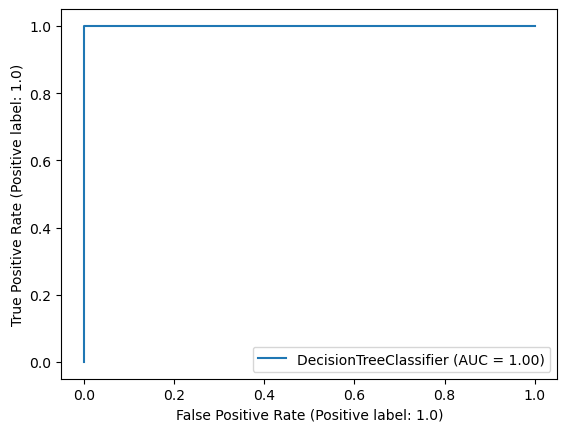

In [134]:
#plot_roc_curve(dt_default, X_train, y_train)
roc_disp = RocCurveDisplay.from_estimator(dt_default, X_train, y_train)
plt.show()

##### Step 8.2.3:Decision Tree Controlling the depth of the tree

In [135]:
dt_depth = DecisionTreeClassifier(max_depth=3)
dt_depth.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=3)

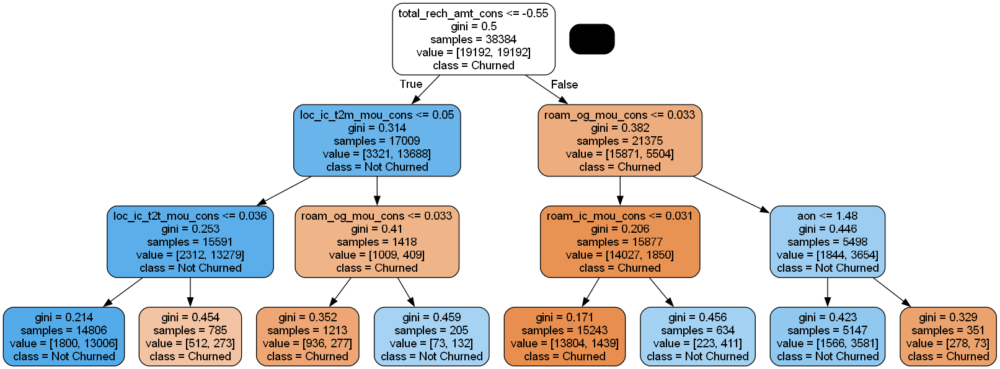

In [136]:
gph = get_dt_graph(dt_depth) 
Image(gph.create_png())

In [137]:
evaluate_model(dt_depth)

Train Accuracy : 0.8508753647353063
Train Recall : 0.8925593997498958
Train Precision : 0.8238745671412081
Train Confusion Matrix:
[[15530  3662]
 [ 2062 17130]]
--------------------------------------------------
Test Accuracy : 0.8136383829409152
Test Recall : 0.8084832904884319
Test Precision : 0.29147358665430956
Test Confusion Matrix:
[[6697 1529]
 [ 149  629]]


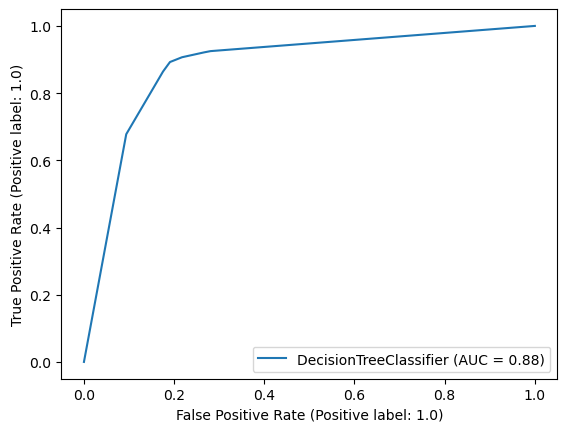

In [138]:
#plot_roc_curve(dt_depth, X_train, y_train)
roc_disp = RocCurveDisplay.from_estimator(dt_depth, X_train, y_train)
plt.show()

In [139]:
dt_depth.feature_importances_

array([0.01569534, 0.        , 0.        , 0.        , 0.03748698,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.04214527,
       0.        , 0.        , 0.        , 0.56950714, 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.25237109,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.08279419, 0.        ,
       0.        , 0.        ])

In [140]:
imp_df = pd.DataFrame({
    "Varname": X_train.columns,
    "Imp": dt_depth.feature_importances_
})

In [141]:
imp_df.sort_values(by="Imp", ascending=False)

,Varname,Imp
23,total_rech_amt_cons,0.57
29,roam_og_mou_cons,0.25
38,loc_ic_t2m_mou_cons,0.08
19,loc_ic_t2t_mou_cons,0.04
4,roam_ic_mou_cons,0.04
0,aon,0.02
37,spl_ic_mou_cons,0.00
36,std_ic_mou_cons,0.00
35,std_ic_t2f_mou_cons,0.00
34,loc_og_t2t_mou_cons,0.00


###### Step8.2.4: Decision Tree Specifying minimum samples before split

In [142]:
dt_min_split = DecisionTreeClassifier(min_samples_split=20)
dt_min_split.fit(X_train, y_train)

DecisionTreeClassifier(min_samples_split=20)

In [143]:
gph = get_dt_graph(dt_min_split) 
Image(gph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.56129 to fit



In [144]:
evaluate_model(dt_min_split)

Train Accuracy : 0.9699614422676115
Train Recall : 0.9657669862442685
Train Precision : 0.9739372602595765
Train Confusion Matrix:
[[18696   496]
 [  657 18535]]
--------------------------------------------------
Test Accuracy : 0.8712794313638383
Test Recall : 0.589974293059126
Test Precision : 0.3533487297921478
Test Confusion Matrix:
[[7386  840]
 [ 319  459]]


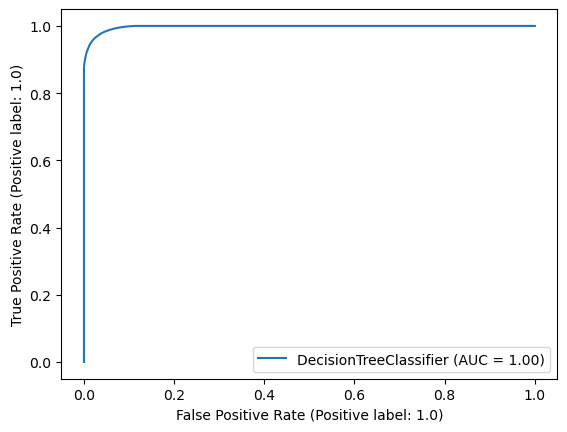

In [145]:
#plot_roc_curve(dt_min_split, X_train, y_train)
roc_disp = RocCurveDisplay.from_estimator(dt_min_split, X_train, y_train)
plt.show()

##### Step8.2.5: Decision Tree Specifying minimum samples in leaf node

In [146]:
dt_min_leaf = DecisionTreeClassifier(min_samples_leaf=20, random_state=42)
dt_min_leaf.fit(X_train, y_train)

DecisionTreeClassifier(min_samples_leaf=20, random_state=42)

In [147]:
gph = get_dt_graph(dt_min_leaf)
Image(gph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.672337 to fit



In [148]:
evaluate_model(dt_min_leaf)

Train Accuracy : 0.9211129637348895
Train Recall : 0.9237703209670696
Train Precision : 0.9188867005286617
Train Confusion Matrix:
[[17627  1565]
 [ 1463 17729]]
--------------------------------------------------
Test Accuracy : 0.8655042203465126
Test Recall : 0.6838046272493573
Test Precision : 0.35537742150968604
Test Confusion Matrix:
[[7261  965]
 [ 246  532]]


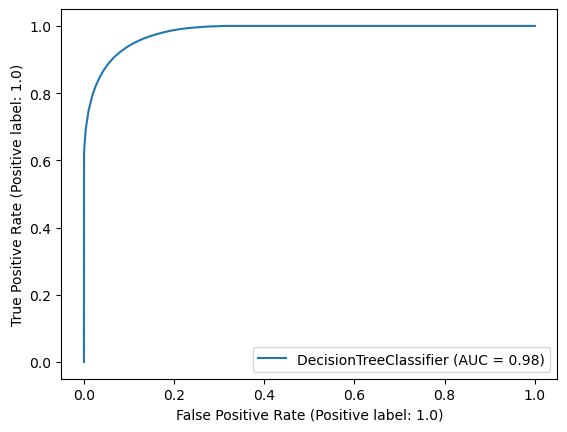

In [149]:
#plot_roc_curve(dt_min_leaf, X_train, y_train)
roc_disp = RocCurveDisplay.from_estimator(dt_min_leaf, X_train, y_train)
plt.show()

##### Step8.2.6: Decision Tree Using Entropy instead of Gini

In [150]:
dt_min_leaf_entropy = DecisionTreeClassifier(min_samples_leaf=20, random_state=42, criterion="entropy")
dt_min_leaf_entropy.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', min_samples_leaf=20,
                       random_state=42)

In [151]:
gph = get_dt_graph(dt_min_leaf_entropy)
Image(gph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.651639 to fit



In [152]:
evaluate_model(dt_min_leaf_entropy)

Train Accuracy : 0.9247082117548979
Train Recall : 0.9263755731554815
Train Precision : 0.9232966348151226
Train Confusion Matrix:
[[17715  1477]
 [ 1413 17779]]
--------------------------------------------------
Test Accuracy : 0.8696135051088405
Test Recall : 0.6555269922879178
Test Precision : 0.3601694915254237
Test Confusion Matrix:
[[7320  906]
 [ 268  510]]


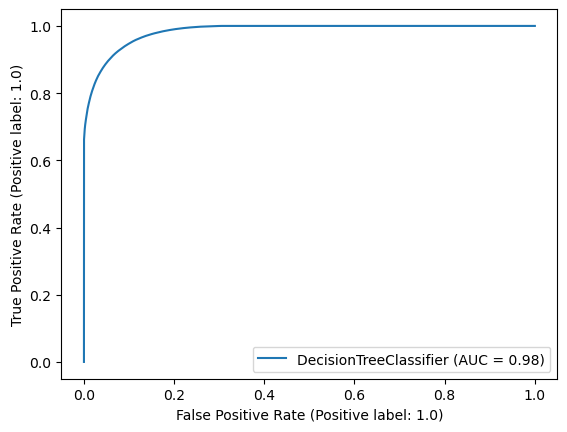

In [153]:
#plot_roc_curve(dt_min_leaf_entropy, X_train, y_train)
roc_disp = RocCurveDisplay.from_estimator(dt_min_leaf_entropy, X_train, y_train)
plt.show()

##### Step 8.2.7: Hyper parameter tuning using Grid Search 

In [154]:
dt = DecisionTreeClassifier(random_state=42)

In [155]:
from sklearn.model_selection import GridSearchCV

In [156]:
# Create the parameter grid based on the results of random search 
params = {
    'max_depth': [2, 3, 5, 10, 20],
    'min_samples_leaf': [5, 10, 20, 50, 100],
    'min_samples_split': [5, 10, 20, 50, 100],
    'criterion': ["gini", "entropy"]
}

In [157]:
# Instantiate the grid search model
grid_search = GridSearchCV(estimator=dt, 
                           param_grid=params, 
                           cv=4, n_jobs=-1, verbose=1, scoring = "accuracy")

In [158]:
%%time
grid_search.fit(X_train, y_train)

Fitting 4 folds for each of 250 candidates, totalling 1000 fits
CPU times: total: 1min 24s
Wall time: 13min 53s


GridSearchCV(cv=4, estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [2, 3, 5, 10, 20],
                         'min_samples_leaf': [5, 10, 20, 50, 100],
                         'min_samples_split': [5, 10, 20, 50, 100]},
             scoring='accuracy', verbose=1)

In [159]:
score_df = pd.DataFrame(grid_search.cv_results_)
score_df.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_samples_leaf,param_min_samples_split,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,0.88,0.03,0.03,0.02,gini,2,5,5,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.82,0.84,0.84,0.83,0.83,0.01,201
1,0.97,0.03,0.02,0.01,gini,2,5,10,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.82,0.84,0.84,0.83,0.83,0.01,201
2,0.92,0.05,0.02,0.00,gini,2,5,20,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.82,0.84,0.84,0.83,0.83,0.01,201
3,0.97,0.05,0.02,0.01,gini,2,5,50,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.82,0.84,0.84,0.83,0.83,0.01,201
4,0.91,0.04,0.01,0.00,gini,2,5,100,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.82,0.84,0.84,0.83,0.83,0.01,201


In [160]:
score_df.nlargest(5,"mean_test_score")

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_samples_leaf,param_min_samples_split,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
100,7.08,0.08,0.01,0.00,gini,20,5,5,"{'criterion': 'gini', 'max_depth': 20, 'min_sa...",0.88,0.90,0.91,0.90,0.90,0.01,1
101,7.03,0.03,0.02,0.01,gini,20,5,10,"{'criterion': 'gini', 'max_depth': 20, 'min_sa...",0.88,0.90,0.91,0.90,0.90,0.01,1
225,7.53,0.28,0.01,0.00,entropy,20,5,5,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.88,0.90,0.90,0.90,0.90,0.01,3
226,7.44,0.20,0.01,0.00,entropy,20,5,10,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.88,0.90,0.90,0.90,0.90,0.01,3
102,7.04,0.15,0.01,0.00,gini,20,5,20,"{'criterion': 'gini', 'max_depth': 20, 'min_sa...",0.88,0.90,0.90,0.90,0.89,0.01,5


In [161]:
grid_search.best_estimator_

DecisionTreeClassifier(max_depth=20, min_samples_leaf=5, min_samples_split=5,
                       random_state=42)

In [162]:
dt_best = grid_search.best_estimator_

In [163]:
evaluate_model(dt_best)

Train Accuracy : 0.9573520216756982
Train Recall : 0.9690496040016674
Train Precision : 0.9468967975154015
Train Confusion Matrix:
[[18149  1043]
 [  594 18598]]
--------------------------------------------------
Test Accuracy : 0.8676143936028432
Test Recall : 0.6735218508997429
Test Precision : 0.35841313269493846
Test Confusion Matrix:
[[7288  938]
 [ 254  524]]


In [164]:
from sklearn.metrics import classification_report

In [165]:
print(classification_report(y_test, dt_best.predict(X_test)))

              precision    recall  f1-score   support

         0.0       0.97      0.89      0.92      8226
         1.0       0.36      0.67      0.47       778

    accuracy                           0.87      9004
   macro avg       0.66      0.78      0.70      9004
weighted avg       0.91      0.87      0.88      9004



dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.447349 to fit



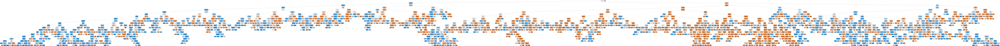

In [166]:
gph = get_dt_graph(dt_best)
Image(gph.create_png())

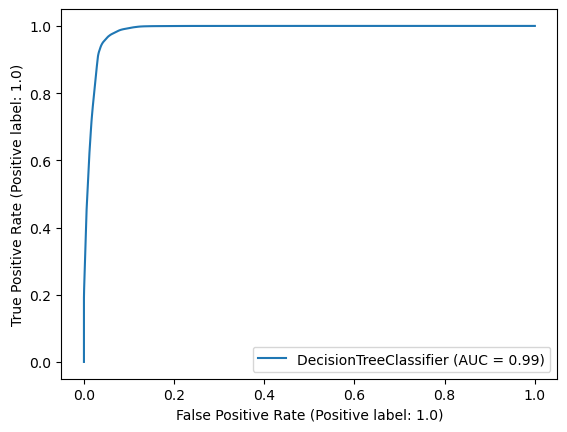

In [167]:
# plot_roc_curve(dt_best, X_train, y_train)
roc_disp = RocCurveDisplay.from_estimator(dt_best, X_train, y_train)
plt.show()

#### Step8.3: Random Forest
##### Step8.3.1:Using random parameters

In [168]:
from sklearn.ensemble import RandomForestClassifier

In [169]:
rf = RandomForestClassifier(n_estimators=10, max_depth=4, max_features=5, random_state=100, oob_score=True)

In [170]:
%%time
rf.fit(X_train, y_train)

CPU times: total: 1.89 s
Wall time: 1.9 s


RandomForestClassifier(max_depth=4, max_features=5, n_estimators=10,
                       oob_score=True, random_state=100)

In [171]:
rf.oob_score_

0.8229210087536474

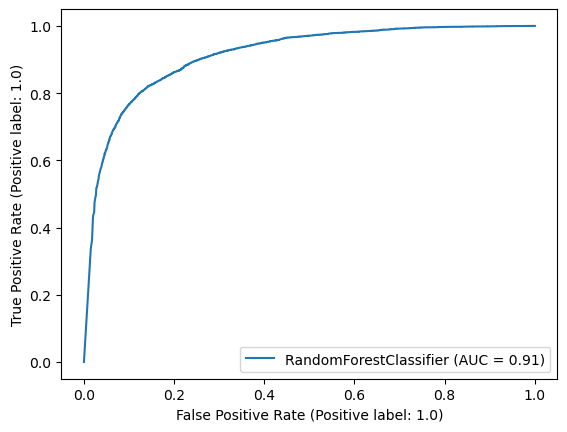

In [172]:
#plot_roc_curve(rf, X_train, y_train)
roc_disp = RocCurveDisplay.from_estimator(rf, X_train, y_train)
plt.show()

In [173]:
evaluate_model(rf)

Train Accuracy : 0.8381617340558566
Train Recall : 0.8108586911213005
Train Precision : 0.8576940035273368
Train Confusion Matrix:
[[16610  2582]
 [ 3630 15562]]
--------------------------------------------------
Test Accuracy : 0.8545091070635273
Test Recall : 0.7609254498714653
Test Precision : 0.34498834498834496
Test Confusion Matrix:
[[7102 1124]
 [ 186  592]]


##### Step 8.3.2: Hyper-parameter tuning for the Random Forest

In [174]:
rf = RandomForestClassifier(random_state=42, n_jobs=-1)

In [175]:
params = {
    'max_depth': [2,3,5,10,20],
    'min_samples_leaf': [5,10,20,50,100,200],
    'n_estimators': [10, 25, 50, 100]
}

In [176]:
grid_search = GridSearchCV(estimator=rf,
                           param_grid=params,
                           cv = 4,
                           n_jobs=-1, verbose=1, scoring="accuracy")

In [177]:
%%time
grid_search.fit(X_train, y_train)

Fitting 4 folds for each of 120 candidates, totalling 480 fits
CPU times: total: 2min 12s
Wall time: 1h 16min 58s


GridSearchCV(cv=4, estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [2, 3, 5, 10, 20],
                         'min_samples_leaf': [5, 10, 20, 50, 100, 200],
                         'n_estimators': [10, 25, 50, 100]},
             scoring='accuracy', verbose=1)

In [178]:
grid_search.best_score_

0.9365621092121718

In [179]:
rf_best = grid_search.best_estimator_
rf_best

RandomForestClassifier(max_depth=20, min_samples_leaf=5, n_jobs=-1,
                       random_state=42)

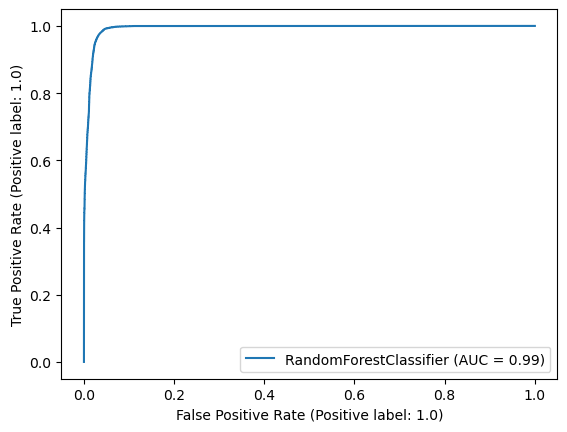

In [180]:
#plot_roc_curve(rf_best, X_train, y_train)
roc_disp = RocCurveDisplay.from_estimator(rf_best, X_train, y_train)
plt.show()

In [181]:
rf_best.feature_importances_

array([0.01551698, 0.00585344, 0.01804517, 0.07768732, 0.07125965,
       0.02955275, 0.00178778, 0.0087195 , 0.00213256, 0.01739829,
       0.01989468, 0.00604048, 0.00621462, 0.03749574, 0.04895319,
       0.05685649, 0.04528762, 0.00619987, 0.05062423, 0.03156989,
       0.01065198, 0.01261924, 0.01592268, 0.09406893, 0.03495235,
       0.01327347, 0.01446859, 0.00678605, 0.00864407, 0.07766432,
       0.02185479, 0.02381086, 0.00337398, 0.00335185, 0.01711336,
       0.00684672, 0.02275431, 0.00769895, 0.02770429, 0.00941767,
       0.00414786, 0.0057834 ])

In [182]:
imp_df = pd.DataFrame({
    "Varname": X_train.columns,
    "Imp": rf_best.feature_importances_
})

In [183]:
imp_df.sort_values(by="Imp", ascending=False)

,Varname,Imp
23,total_rech_amt_cons,0.09
3,arpu_cons,0.08
29,roam_og_mou_cons,0.08
4,roam_ic_mou_cons,0.07
15,last_day_rch_amt_cons,0.06
18,std_og_mou_cons,0.05
14,max_rech_amt_cons,0.05
16,total_og_mou_cons,0.05
13,total_rech_num_cons,0.04
24,loc_ic_mou_cons,0.03


In [184]:
evaluate_model(rf_best)

Train Accuracy : 0.9720195914964569
Train Recall : 0.9857753230512714
Train Precision : 0.9593813387423935
Train Confusion Matrix:
[[18391   801]
 [  273 18919]]
--------------------------------------------------
Test Accuracy : 0.9120390937361172
Test Recall : 0.7300771208226221
Test Precision : 0.49391304347826087
Test Confusion Matrix:
[[7644  582]
 [ 210  568]]


#### Step 9: Summary And Conclusion
Now let us summarize our findings from the model building exercise and draw conclusions and recommendations 

#### Step 9.1: Model Comparison
- We started by creating a basic model using Logistic Regression that had a class imbalance data and figured out that it had a very low recall value of 14% and a high accuracy of 91%
- Hence using the SMOTE technique we created a base model which gave a accuracy of 76%
- To further improve the recall we built various models using different techniques like 
        - Logistic Regression with RFE
        - Decision Tree
        - Random Forest

|Model Type |Test Accuracy |Test Recall |Test Precision |ROC-AUC Score|
|:-:|:-:|:-:|:-:|:-:|
|LR(with Class Imbalance)|91.7%|14%|59.6%|  |
|LR(BaseModel with SMOTE)|80%|76.7%|27%| |
|LR(with RFE) |80%|77%|27%|79%|
|Decision Tree(with default parameters except depth=5)|84%|79%|32%|82%|
|Decsion Tree (without any hyperparameter)|86.7%|59%|33.7%|100%|
|Decision Tree(max depth=3)|81.3%|80.8%|29%|88%|
|Decision Tree(minimum samples before split=20)|87.5%|60%|36%|100%|
|Decision Tree(minimum samples in leaf node=20)|86.5%|68%|35.5%|98%|
|Decision Tree Using Entropy|87%|66.5%|36.4%|98%|
|Decision Tree(Hyperparameter tuning using GridSearch)|86.7%|67.6%|35.9%|99%|
|Random Forest(Using Random Parameters)|86%|74.6%|36.1%|92%|
|Random Forest(Using Hyperparameter Tuning)|91%|71.8%|48.8%|99%|79|
  
- <b>Conclusion</b>
1. Among all the models, Decision tree with max depth of 3 provides the best recall rates (80.8%). Since we are interested in increasing the True Positives and reducing the False Negatives, Recall is the metric we are focused on
2. Random Forests score very high on the accuracy and ROC but not very good on the Recall metrics when compared to the above Decision Tree
3. The Logistic Regression Model with RFE scored better than Random Forests on the Recall parameter 
4. Hence after Decision Tree the preferred model for this problem statement is Logistic Regression using RFE 
5. The ROC score for all the models have shown a pretty high value > 79%

#### Step 9.2: Identify important predictors
We will use the output of the Decision Tree with max Depth 3 as our final model to identify important predictors

    1.A sharp decline (measured by usage in current month minus average usage in prior 2 months) in the total recharge amount of a customer (total_rech_amt) has a large contribution towards the odds of the customer churning next month. 
    
    2.A considerable decline (measured by current month outgoing call in roaming zone minus average of prior 2 months) in the outgoing calls in roaming zone (roam_og_mou) is the second biggest contributor to the odds of the customer churning.
    
    3. A decline in the incoming calls (measured by current month incoming call minus average of prior 2 months) (loc_ic_t2m_mou,loc_ic_t2t_mou,roam_ic_mou) are the next contibutors to the odds of the customer churning.
    
    4. Age on network (aon) is the next biggest contributer to the odds of the customer churning. This means that newer customers have a higher probability to churn than the old customers

#### Step 9.3: Recommend strategies to manage customer churn

1.<b>Target identified probable churn customers in the action month so that they dont churn</b>

  a. Offer targeted incentives to these customers to continue with the operator. Since the decline in recharge is one of the indicators of churn, these      customers could be offered recharge related incentives
  
  b. Also they can be offered call related (incoming/outgoing) incentives since those are the next important predictor parameters
  
  c. Since the newer customers have a higer probability to churn, target them with monthly recharges or call related deals so that they stick for a     longer period

2.<b>Continuous monitoring and model updates<\b>

  a.Continuously monitor the outcome of the incentives on the churn behaviour and input the same into the model. If needed retune the hyperparameters to make better predictions

  b.In case of any significant event impacting churn, redevelop the model factoring the parameters describing the significant event.